In [4]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [6]:
from tqdm import tqdm
import pandas as pd
from pathlib import Path
import matplotlib.pyplot as plt
import seaborn as sns

from src.utils.config_parser import load_config
from src.pipeline.eda import DataVisualizer
from src.pipeline.dataset_generator import NPSDatasetGenerator, InquiryDatasetGenerator
from src.pipeline.preprocessing import NPSDataProcessor, InquiryDataProcessor
from src.pipeline.anomalies_detector import AnomalyDetector

pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', 100)

In [8]:
DATA_FOLDER = Path('data')

In [9]:
config = load_config('config.yaml')

print(config)

nps_generator_params = config.get("NPSDatasetGenerator", {})
inquiry_generator_params = config.get("InquiryDatasetGenerator", {})
datavis_params = config.get("DataVisualizer", {})
processor_params = config.get("DataProcessor", {})
detector_params = config.get("AnomalyDetector", {})

{'NPSDatasetGenerator': {'data_folder': 'data', 'num_observations': 10000, 'min_date': '2023-01-01', 'max_date': '2024-12-31'}, 'InquiryDatasetGenerator': {'data_folder': 'data', 'num_observations': 10000, 'min_date': '2023-01-01', 'max_date': '2024-12-31'}, 'DataVisualizer': {'output_dir': 'data/imgs'}, 'DataProcessor': {'output_dir': 'data/interim'}, 'AnomalyDetector': {'window_size': 7, 'z_threshold': 3.0, 'ml_contamination': 0.05, 'min_group_size': 2, 'clip_contributions': True, 'output_dir': 'data/processed'}}


# Pipeline Example
In this section we'll use all Metrics values, without aggregating by `measure_id`. This is needed for demonstration only. We use **NPS** and **Inquiry** as main metrics. 

## 1. Generation

In [10]:
# We can change params in `config.yaml` file. Or ypu can pass your own dictionary to DatasetGenerator class
print(nps_generator_params)

{'data_folder': 'data', 'num_observations': 10000, 'min_date': '2023-01-01', 'max_date': '2024-12-31'}


In [11]:
nps_generator = NPSDatasetGenerator(**nps_generator_params)
nps_generator.generate_dataset()

inquiry_generator = InquiryDatasetGenerator(**inquiry_generator_params)
inquiry_generator.generate_dataset()

[2025-03-27 11:38:57 INFO] src.pipeline.dataset_generator: Start Generating NPS data...


[2025-03-27 11:38:59 INFO] src.pipeline.dataset_generator: Dataset shape: (10000, 103)
[2025-03-27 11:38:59 INFO] src.pipeline.dataset_generator: Dataset saved in data/interim/nps_data.csv
[2025-03-27 11:38:59 INFO] src.pipeline.dataset_generator: Start Generating Inquiry data...
[2025-03-27 11:38:59 INFO] src.pipeline.dataset_generator: Dataset shape: (10000, 24)
[2025-03-27 11:38:59 INFO] src.pipeline.dataset_generator: Dataset saved in data/interim/inquiry_data.csv


---


## 2. EDA

In [12]:
data_visualizer = DataVisualizer(nps_path=nps_generator.out_path,
                                inquiry_path=inquiry_generator.out_path,
                                segments_path=f"{nps_generator_params['data_folder']}/raw/segments",
                                **datavis_params)

>*How many missing values out dataset contains?*

[2025-03-27 11:39:01 INFO] src.pipeline.eda: Image saved in path: data/imgs/missing_vals_nps.png


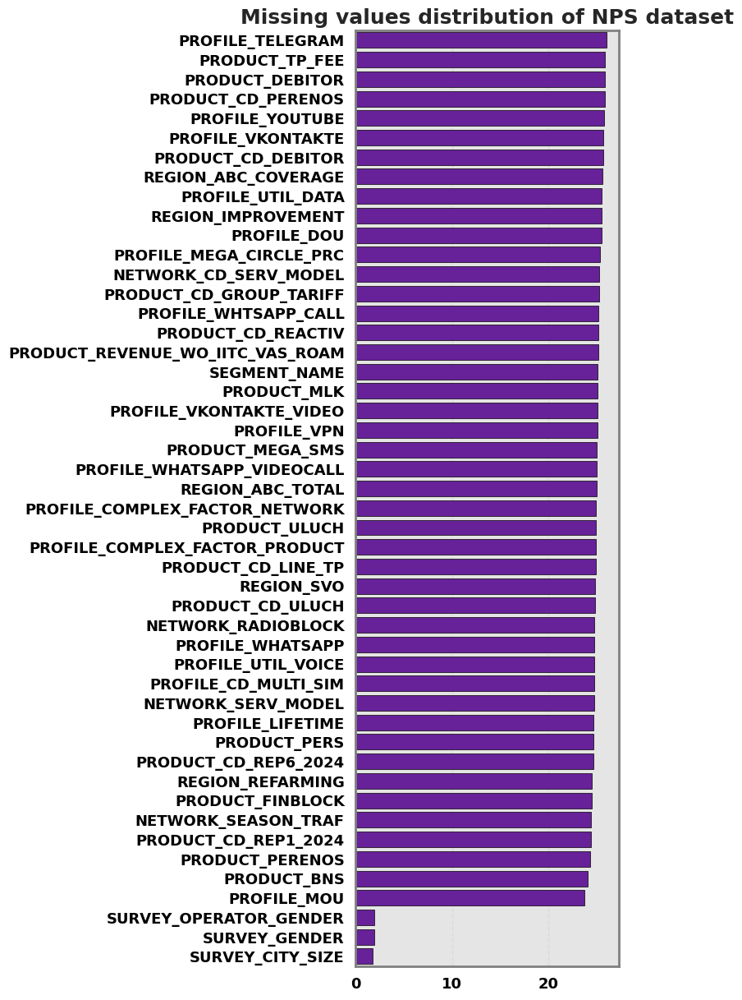

In [13]:
data_visualizer.missing_values_analysis(
    data_visualizer.df_nps, 
    title='Missing values distribution of NPS dataset',
    filename='missing_vals_nps'
)

[2025-03-27 11:39:01 INFO] src.pipeline.eda: Image saved in path: data/imgs/missing_vals_inquiry.png


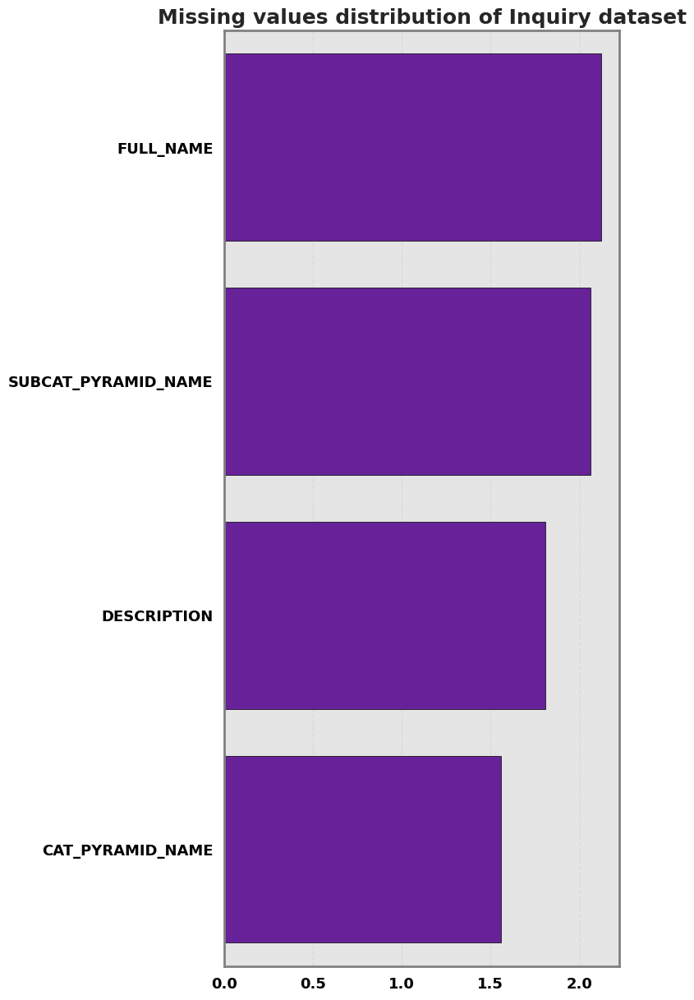

In [14]:
data_visualizer.missing_values_analysis(
    data_visualizer.df_inquiry, 
    title='Missing values distribution of Inquiry dataset',
    filename='missing_vals_inquiry'
)

As we can see, some features (columns) in our dateset contains nothing. In the next session we'll impute these missing values.

>*What is the distribution of groups in the segments-of-interest?*

In [15]:
# Our segments
data_visualizer.nps_segments

['SURVEY_GENDER',
 'FILIAL_ID',
 'SURVEY_ARPU_GROUP',
 'SURVEY_CITY_SIZE',
 'PRODUCT_TARIFF_CHANGE',
 'NETWORK_PROSTOI',
 'NETWORK_VOLTE',
 'NETWORK_VOWIFI',
 'NETWORK_OVERLOAD',
 'NETWORK_SQI_VOICE',
 'NETWORK_SPEED_LTE',
 'NETWORK_DURATION_2G',
 'NETWORK_DURATION_4G',
 'NETWORK_SPD_LOWER_THAN_2000',
 'PRODUCT_PEREPLATY',
 'PROFILE_KINOPOISK',
 'PROFILE_DEVICE_TYPE',
 'PROFILE_DEVICE_OS',
 'PROFILE_DEVICE_PRICE',
 'PRODUCT_EVA_TYPE',
 'NETWORK_SQI_DATA',
 'PRODUCT_NAME_LINE_TP',
 'PRODUCT_GROUP_TARIFF',
 'NETWORK_4G_SHARE',
 'REGION_FILIAL']

[2025-03-27 11:39:10 INFO] src.pipeline.eda: Image saved in path: data/imgs/segments_dist_nps.png


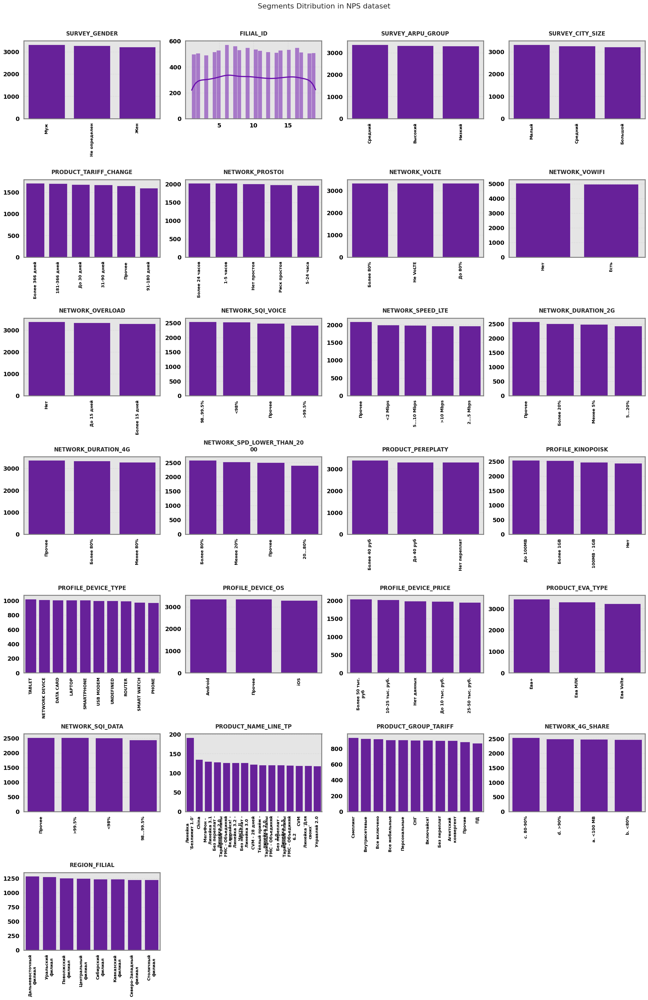

In [16]:
data_visualizer.plot_segments_distribution(
    data_visualizer.df_nps, 
    segments=data_visualizer.nps_segments, # You can pass other segments. But they should be in the dateset. 
    title="Segments Ditribution in NPS dataset",
    filename='segments_dist_nps'
)

[2025-03-27 11:39:12 INFO] src.pipeline.eda: Image saved in path: data/imgs/nps_in_top10_filials.png


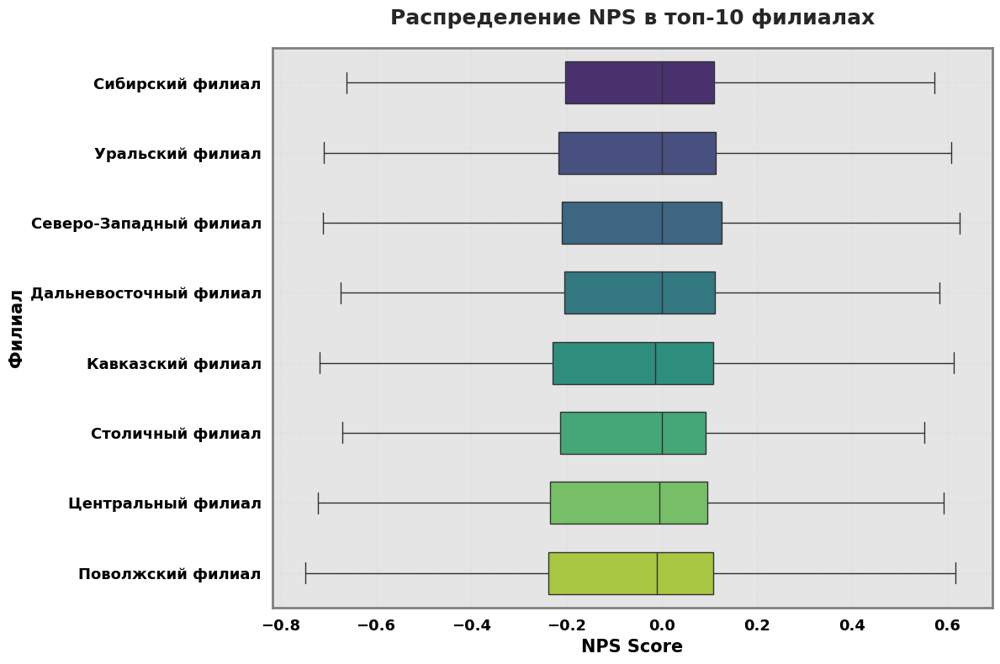

In [17]:
data_visualizer.plot_top_10_filials_nps(
    data_visualizer.df_nps, 
    filename="nps_in_top10_filials"
)

>*Различается ли распределение NPS у пользователей из разных групп по ARPU?*

[2025-03-27 11:39:12 INFO] src.pipeline.eda: Image saved in path: data/imgs/nps_dist_arpu.png


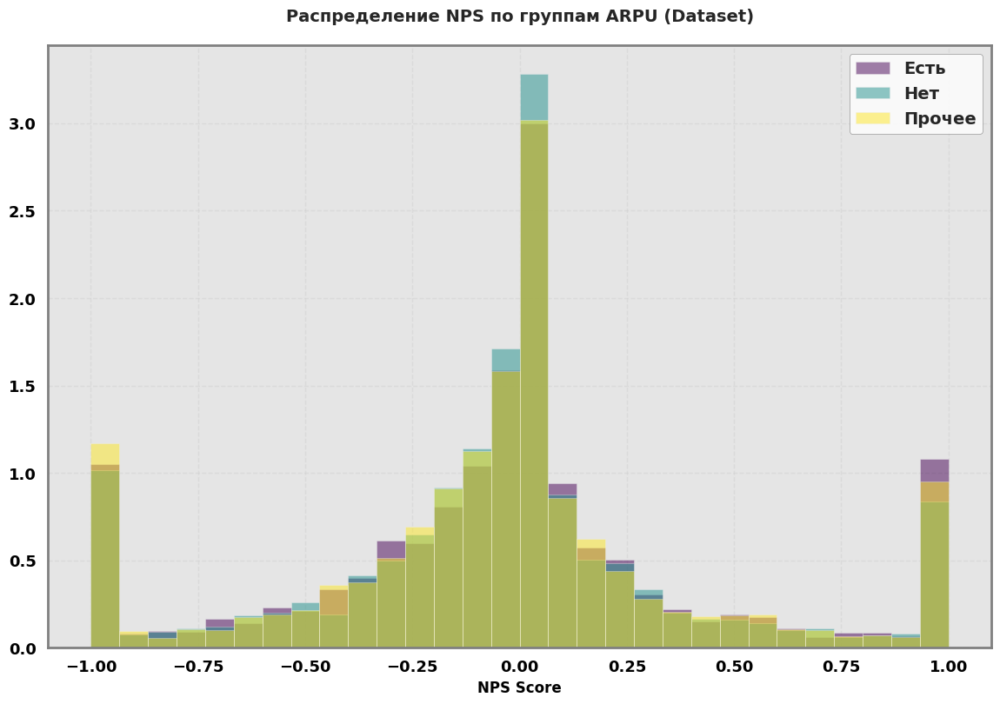

In [18]:
data_visualizer.plot_nps_by_arpu(
    data_visualizer.df_nps, 
    filename='nps_dist_arpu'
)

[2025-03-27 11:39:13 INFO] src.pipeline.eda: Image saved in path: data/imgs/geography_query_distribution.png


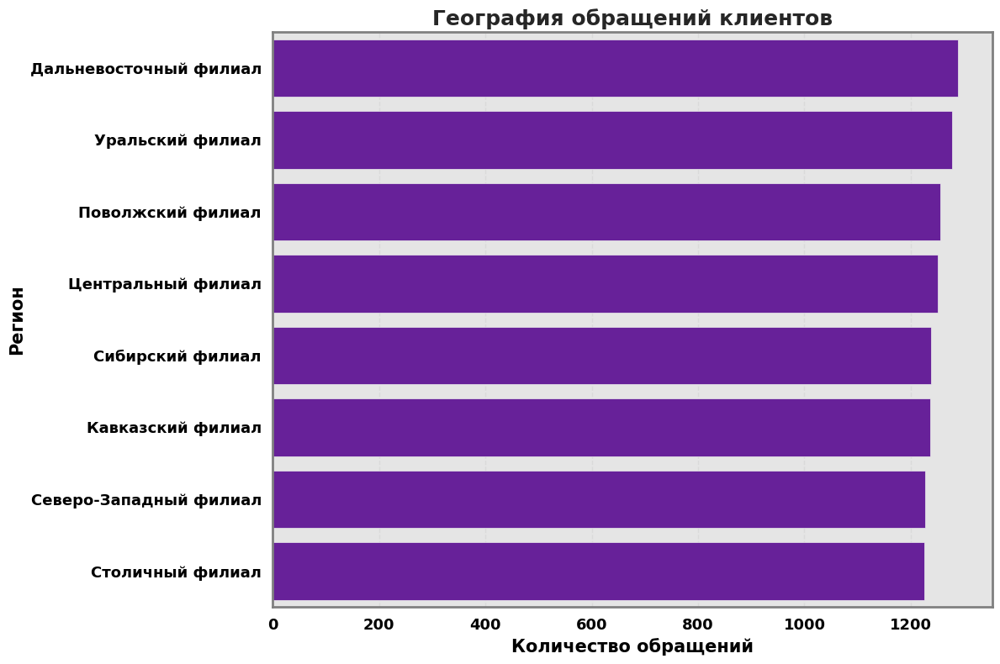

In [19]:
data_visualizer.plot_geography_distribution(
    data_visualizer.df_nps, 
    filename='geography_query_distribution'
)

>*Как средний NPS менялся со временем?*

Берем с временным окном в один день

[2025-03-27 11:39:14 INFO] src.pipeline.eda: Image saved in path: data/imgs/timeline_nps.png


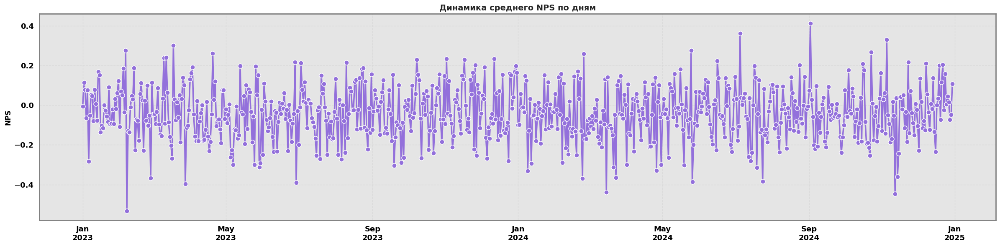

In [20]:
data_visualizer.plot_daily_dynamics(
    df=data_visualizer.df_nps, 
    metric_name='NPS',
    func='mean',
    title='Динамика среднего NPS по дням',
    filename="timeline_nps"
)

>*Как со временем менялось количество обращений?*

[2025-03-27 11:39:16 INFO] src.pipeline.eda: Image saved in path: data/imgs/timeline_inquiry.png


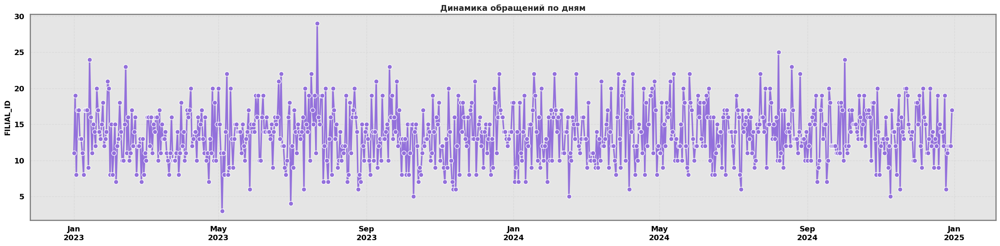

In [21]:
data_visualizer.plot_daily_dynamics(
    df=data_visualizer.df_inquiry, 
    metric_name='FILIAL_ID',  # doesn't matter which column to pass
    func='size',
    title='Динамика обращений по дням',
    filename="timeline_inquiry"
)

Timeline of mean NPS (or another metric) in different segments. Let's see some five segments.

In [22]:
# all segments in NPS dataset
data_visualizer.nps_segments

['SURVEY_GENDER',
 'FILIAL_ID',
 'SURVEY_ARPU_GROUP',
 'SURVEY_CITY_SIZE',
 'PRODUCT_TARIFF_CHANGE',
 'NETWORK_PROSTOI',
 'NETWORK_VOLTE',
 'NETWORK_VOWIFI',
 'NETWORK_OVERLOAD',
 'NETWORK_SQI_VOICE',
 'NETWORK_SPEED_LTE',
 'NETWORK_DURATION_2G',
 'NETWORK_DURATION_4G',
 'NETWORK_SPD_LOWER_THAN_2000',
 'PRODUCT_PEREPLATY',
 'PROFILE_KINOPOISK',
 'PROFILE_DEVICE_TYPE',
 'PROFILE_DEVICE_OS',
 'PROFILE_DEVICE_PRICE',
 'PRODUCT_EVA_TYPE',
 'NETWORK_SQI_DATA',
 'PRODUCT_NAME_LINE_TP',
 'PRODUCT_GROUP_TARIFF',
 'NETWORK_4G_SHARE',
 'REGION_FILIAL']

In [23]:
def get_daily_nps_params(segment):
    return {
        'df': data_visualizer.df_nps,
        'segment': segment,
        'metric_name': 'NPS', 
        'func': 'mean',
        'title': "Daily NPS dynamic",
        'output_dir': data_visualizer.output_dir / "segments_nps_time",
        'filename': f"timeline_nps_{segment}"
    }

[2025-03-27 11:39:19 INFO] src.pipeline.eda: Image saved in path: data/imgs/segments_nps_time/timeline_nps_SURVEY_ARPU_GROUP.png


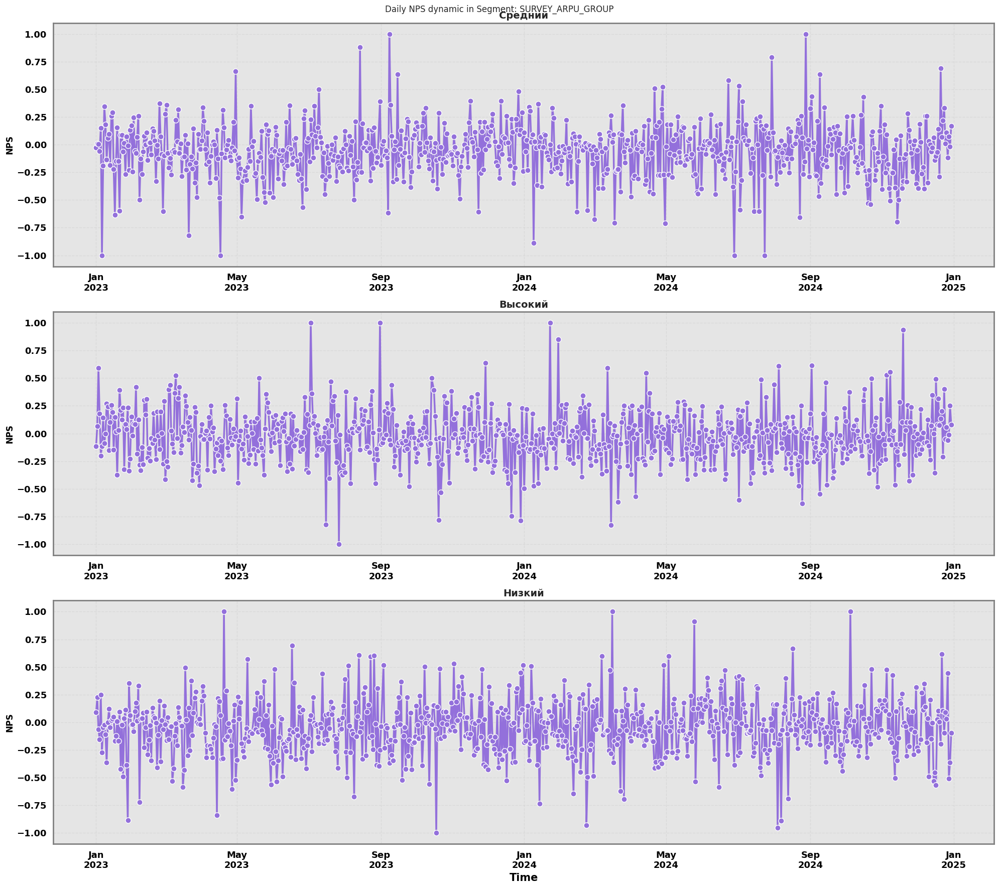

In [24]:
data_visualizer.plot_daily_dynamics_segment(
    **get_daily_nps_params('SURVEY_ARPU_GROUP')
)

[2025-03-27 11:39:23 INFO] src.pipeline.eda: Image saved in path: data/imgs/segments_nps_time/timeline_nps_SURVEY_GENDER.png


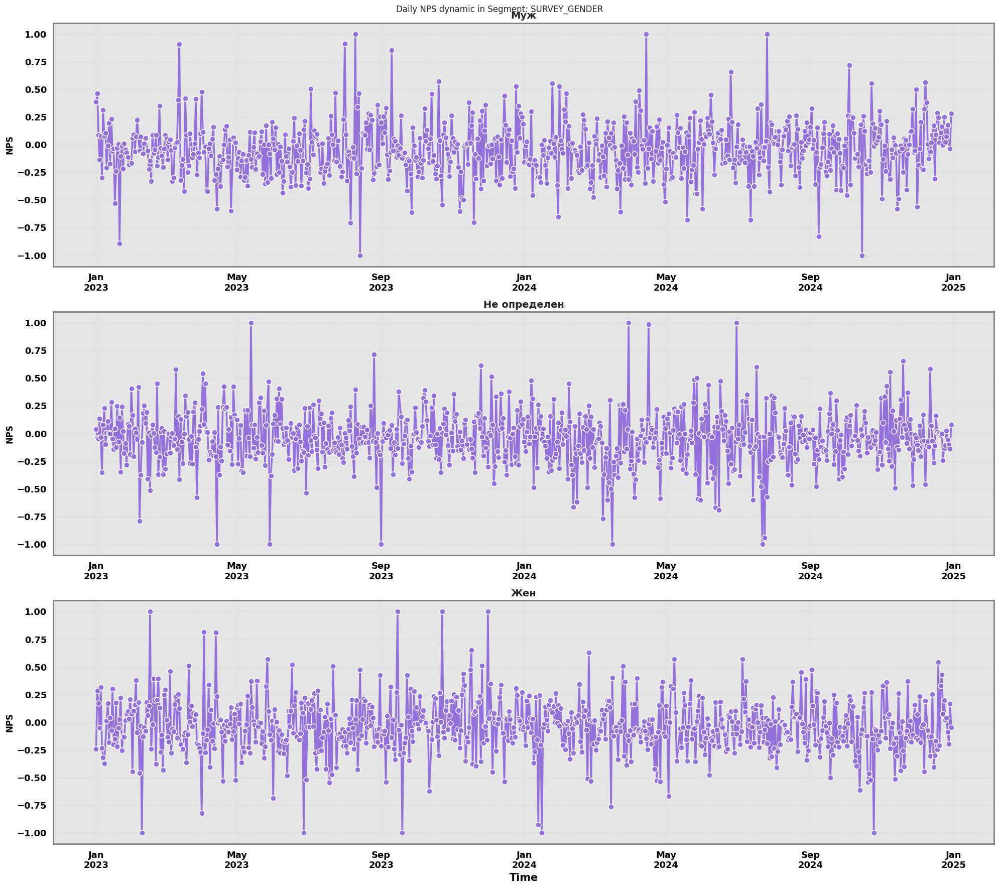

In [25]:
data_visualizer.plot_daily_dynamics_segment(
    **get_daily_nps_params('SURVEY_GENDER')
)

[2025-03-27 11:39:27 INFO] src.pipeline.eda: Image saved in path: data/imgs/segments_nps_time/timeline_nps_SURVEY_CITY_SIZE.png


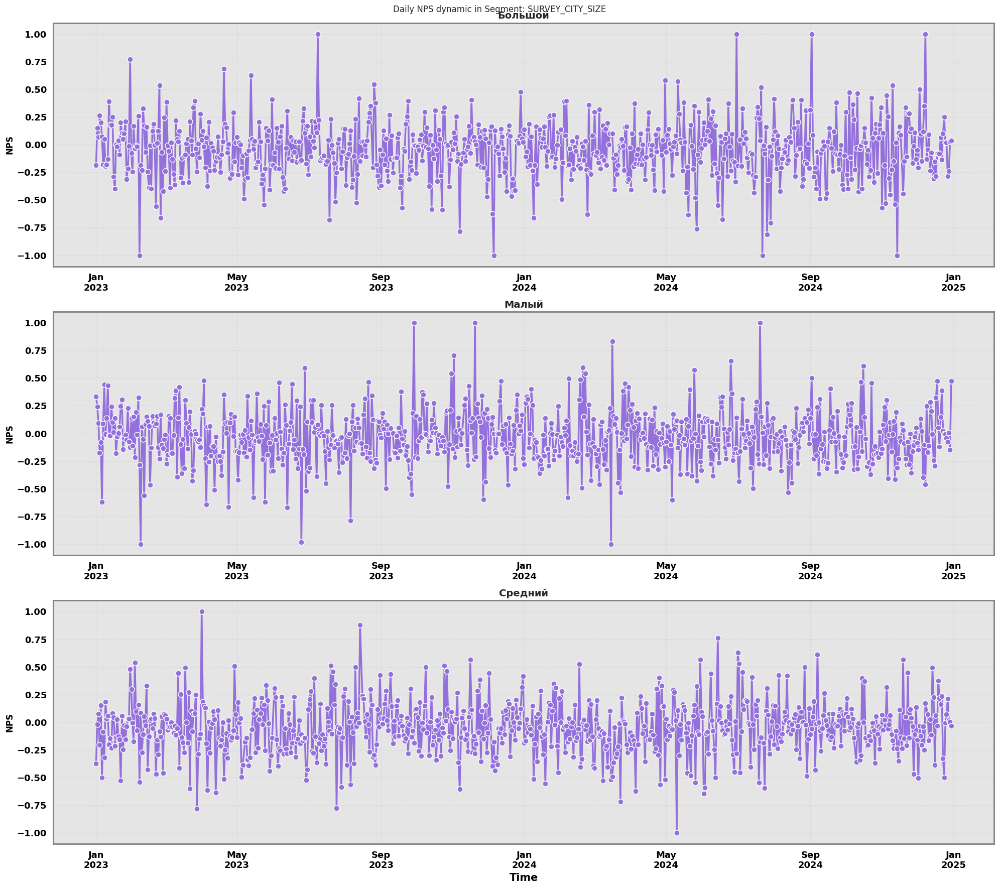

In [26]:
data_visualizer.plot_daily_dynamics_segment(
    **get_daily_nps_params('SURVEY_CITY_SIZE')
)

[2025-03-27 11:39:30 INFO] src.pipeline.eda: Image saved in path: data/imgs/segments_nps_time/timeline_nps_PRODUCT_EVA_TYPE.png


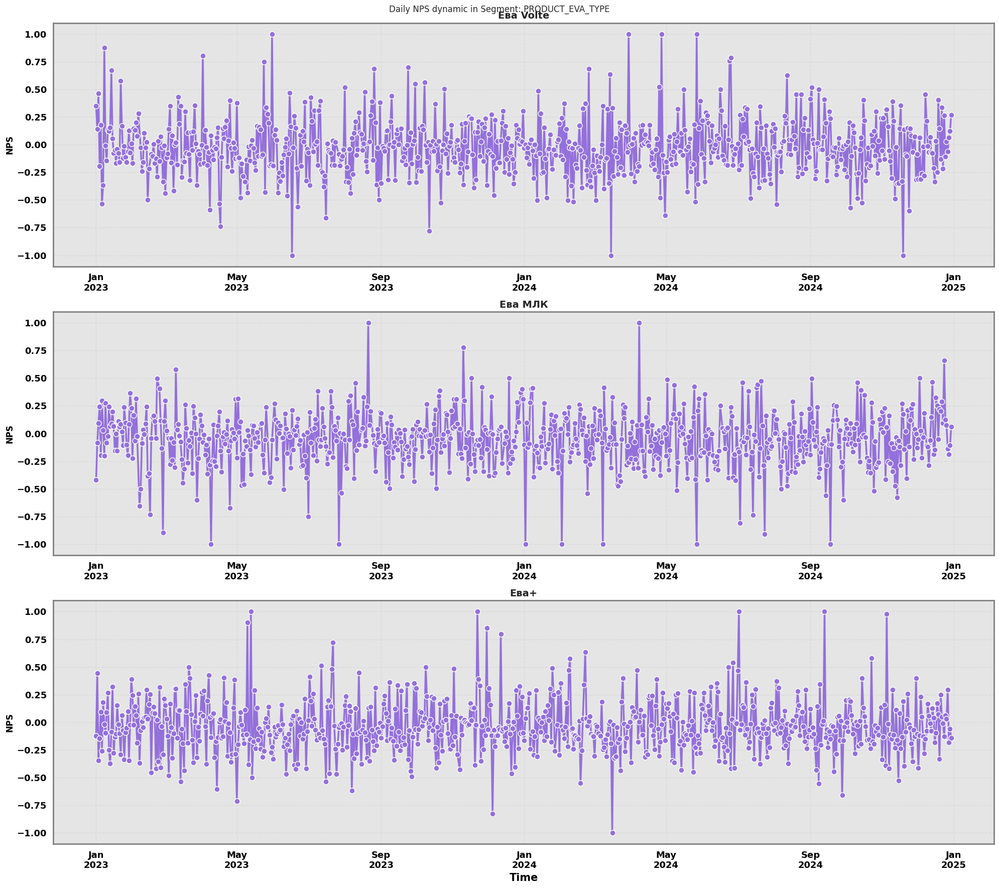

In [27]:
data_visualizer.plot_daily_dynamics_segment(
    **get_daily_nps_params('PRODUCT_EVA_TYPE')
)

And timeline of total Inquiry

In [28]:
def get_daily_inquiry_params(segment):
    return {
        'df': data_visualizer.df_inquiry,
        'segment': segment,
        'metric_name': 'FILIAL_ID', 
        'func': 'size',
        'title': "Daily Inquiry dynamic",
        'output_dir': data_visualizer.output_dir / "segments_inquiry_time",
        'filename': f"timeline_inquiry_{segment}"
    }

data_visualizer.inquiry_segments

['FILIAL_ID',
 'DESCRIPTION',
 'SUBCAT_PYRAMID_NAME',
 'FULL_NAME',
 'CAT_PYRAMID_NAME',
 'FLAG_LOCAL_GENERAL']

[2025-03-27 11:39:34 INFO] src.pipeline.eda: Image saved in path: data/imgs/segments_inquiry_time/timeline_inquiry_DESCRIPTION.png


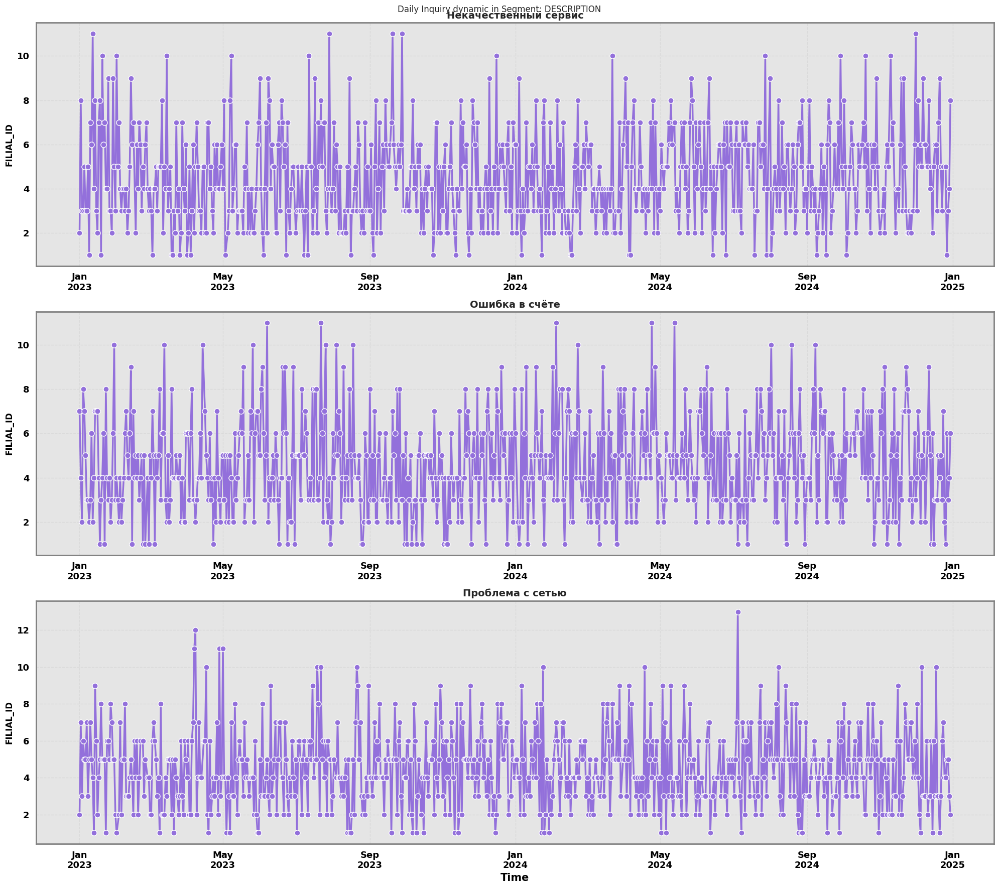

In [29]:
data_visualizer.plot_daily_dynamics_segment(
    **get_daily_inquiry_params('DESCRIPTION')
)

[2025-03-27 11:39:36 INFO] src.pipeline.eda: Image saved in path: data/imgs/segments_inquiry_time/timeline_inquiry_CAT_PYRAMID_NAME.png


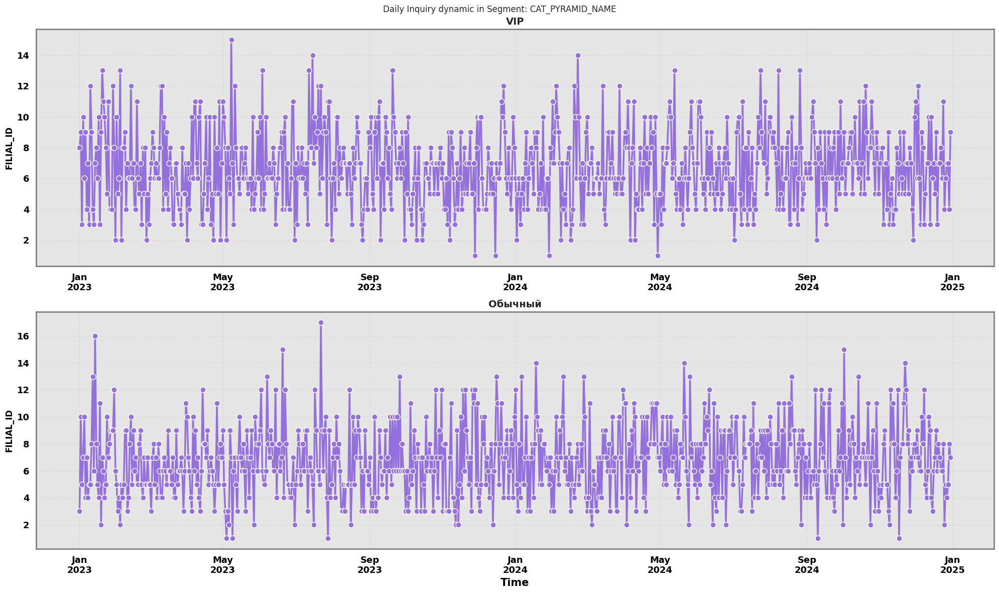

In [30]:
data_visualizer.plot_daily_dynamics_segment(
    **get_daily_inquiry_params('CAT_PYRAMID_NAME')
)

[2025-03-27 11:39:38 INFO] src.pipeline.eda: Image saved in path: data/imgs/segments_inquiry_time/timeline_inquiry_SUBCAT_PYRAMID_NAME.png


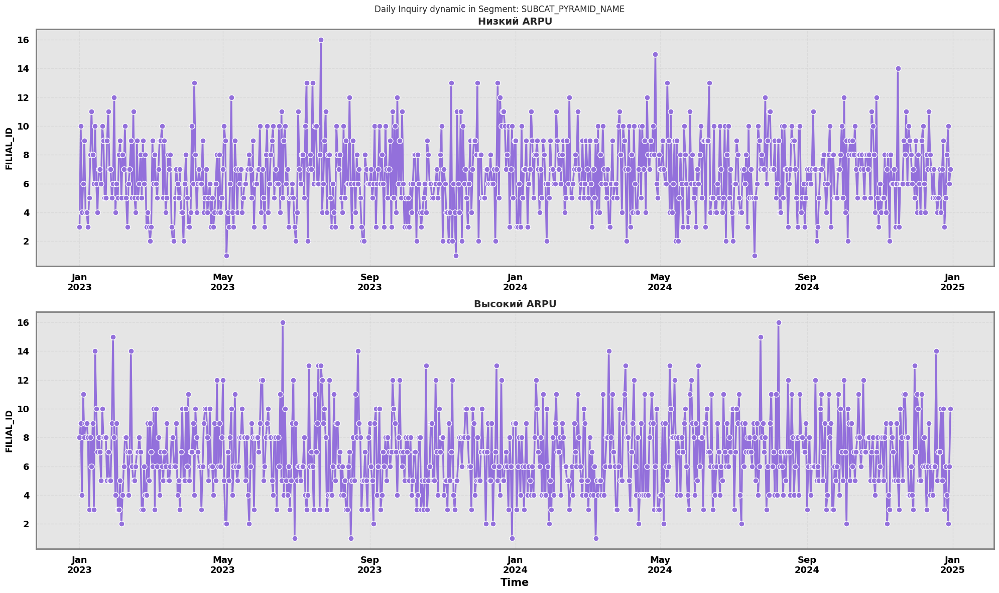

In [31]:
data_visualizer.plot_daily_dynamics_segment(
    **get_daily_inquiry_params('SUBCAT_PYRAMID_NAME')
)

>*Is there significant correlation between Mean NPS and Total Inquiry?*

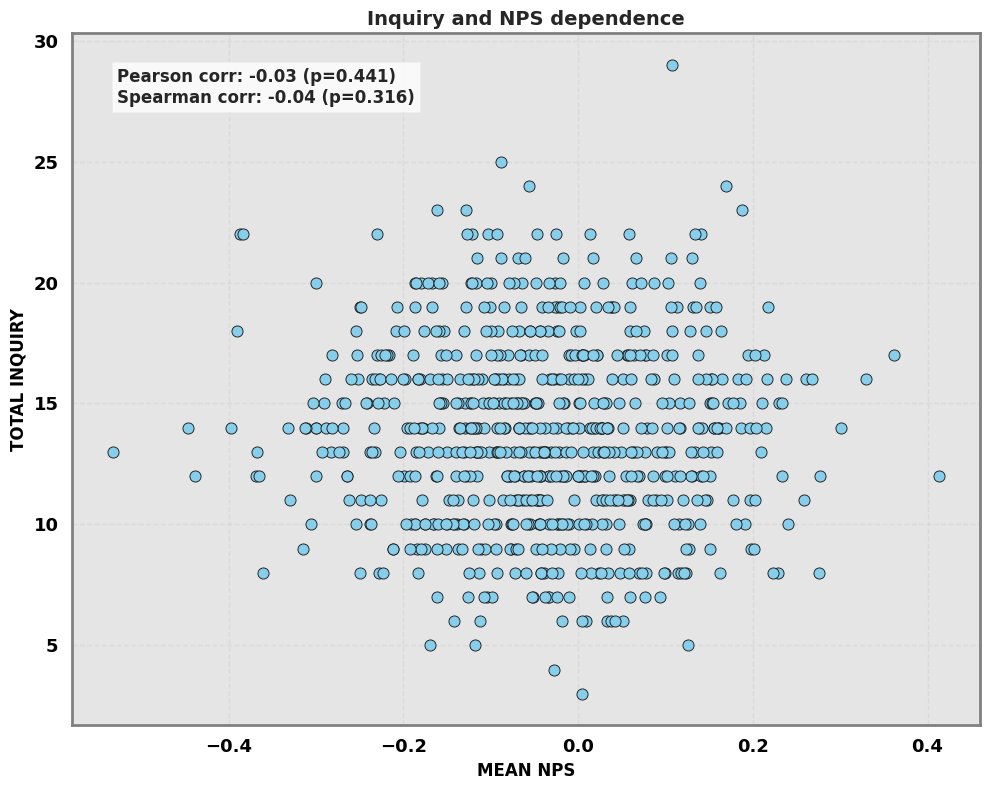

In [32]:
data_visualizer.plot_correlation_daily_metrics(
    df1=data_visualizer.df_nps, df2=data_visualizer.df_inquiry,
    group_col1='NPS', group_col2='FILIAL_ID',
    func1='mean', func2='size',
    metric1_name='MEAN NPS', metric2_name='TOTAL INQUIRY',
    title='Inquiry and NPS dependence'
)

---

## 3. Processing

- Select segment columns
- Impute missing values with kNN (numeric features) and Decision Trees (categorical columns)
- Binning of the numeric segment  (make them categorical)
- Group by dates (daily timestemp, but we can change)

In [33]:
nps_processor = NPSDataProcessor(data_path=nps_generator.out_path, output_name="nps_processed", **processor_params)
inquiry_processor = InquiryDataProcessor(data_path=inquiry_generator.out_path, output_name="inquiry_processed", **processor_params)

nps_processor.process()
inquiry_processor.process()

[2025-03-27 11:39:39 INFO] src.pipeline.preprocessing: NPSDataProcessor: Initial dataset shape: (10000, 103)
[2025-03-27 11:39:39 INFO] src.pipeline.preprocessing: NPSDataProcessor: Initial dataset shape: (10000, 106)
[2025-03-27 11:39:39 INFO] src.pipeline.preprocessing: NPSDataProcessor: Filling missing values using ML models...
[2025-03-27 11:39:39 INFO] src.pipeline.preprocessing: Initial missing values distribution: 
PROFILE_KINOPOISK                0
PRODUCT_EVA_TYPE                 0
NETWORK_DURATION_2G              0
SURVEY_GENDER                  199
SURVEY_CITY_SIZE               179
NETWORK_VOWIFI                   0
REGION_FILIAL                    0
NETWORK_PROSTOI                  0
NETWORK_DURATION_4G              0
PROFILE_DEVICE_PRICE             0
SURVEY_OPERATOR_AGE_GROUP        0
PRODUCT_NAME_LINE_TP             0
SNAP_DATE_DAY                    0
PRODUCT_PEREPLATY                0
SURVEY_ARPU_GROUP                0
NETWORK_4G_SHARE                 0
PROFILE_DEVICE

In [34]:
nps = pd.read_csv(nps_processor.output_file)
nps.head()

,PROFILE_KINOPOISK,PRODUCT_EVA_TYPE,NETWORK_DURATION_2G,SURVEY_GENDER,SURVEY_CITY_SIZE,NETWORK_VOWIFI,REGION_FILIAL,NETWORK_PROSTOI,NETWORK_DURATION_4G,PROFILE_DEVICE_PRICE,SURVEY_OPERATOR_AGE_GROUP,PRODUCT_NAME_LINE_TP,SNAP_DATE_DAY,PRODUCT_PEREPLATY,SURVEY_ARPU_GROUP,NETWORK_4G_SHARE,PROFILE_DEVICE_OS,FILIAL_ID,SURVEY_AGE_GROUP,NPS,PROFILE_DEVICE_TYPE,NETWORK_SQI_DATA,NETWORK_SQI_VOICE,PRODUCT_TARIFF_CHANGE,NETWORK_OVERLOAD,NETWORK_SPD_LOWER_THAN_2000,NETWORK_SPEED_LTE,PRODUCT_GROUP_TARIFF,NETWORK_VOLTE
0,До 100MB,Ева Volte,Прочее,Муж,Большой,Есть,Столичный филиал,1-5 часов,Более 80%,Нет данных,55+,Управляй!+ 2.0,2023-09-29,До 40 руб,Средний,d. >90%,Прочее,9.0,55+,-0.027934,SMARTPHONE,>99.5%,<98%,91-180 дней,До 15 дней,20...80%,5...10 Mbps,Внутрисетевые,Не VoLTE
1,Нет,Ева МЛК,Более 20%,Муж,Малый,Нет,Дальневосточный филиал,Более 24 часов,Прочее,25-50 тыс. руб.,55+,Включайся! - Линейка 2 Огненный щит,2023-10-28,Нет переплат,Средний,b. <80%,Android,12.0,35-44,-0.890167,SMARTPHONE,Прочее,>99.5%,Прочее,Более 15 дней,Менее 20%,>10 Mbps,Прочие,До 80%
2,Более 1GB,Ева+,5...20%,Муж,Большой,Нет,Дальневосточный филиал,1-5 часов,Более 80%,10-25 тыс. руб.,18-24,Тёплый приём - линейка 4.0,2023-08-10,Нет переплат,Высокий,b. <80%,iOS,5.0,45-54,1.000000,USB MODEM,>99.5%,<98%,31-90 дней,Нет,Менее 20%,2...5 Mbps,Сэмплинг,Более 80%
3,Нет,Ева Volte,Прочее,Муж,Большой,Есть,Столичный филиал,5-24 часа,Более 80%,До 10 тыс. руб.,18-24,Тёплый приём - линейка 4.1,2024-01-18,Нет переплат,Средний,a. <100 MB,Прочее,14.0,55+,0.948641,UNDEFINED,98...99.5%,<98%,Прочее,Нет,Прочее,>10 Mbps,СНГ,До 80%
4,100MB - 1GB,Ева+,Менее 5%,Не определен,Малый,Есть,Северо-Западный филиал,Более 24 часов,Прочее,10-25 тыс. руб.,55+,Включайся! - Линейка 3.2,2024-08-24,До 40 руб,Высокий,a. <100 MB,iOS,8.0,55+,0.231790,NETWORK DEVICE,Прочее,98..99.5%,181-366 дней,Более 15 дней,Более 80%,5...10 Mbps,Все включено,Не VoLTE


In [35]:
inquiry = pd.read_csv(inquiry_processor.output_file)
inquiry.head()

,FULL_NAME,SUBCAT_PYRAMID_NAME,FLAG_LOCAL_GENERAL,SNAP_DATE_DAY,FILIAL_ID,CAT_PYRAMID_NAME,DESCRIPTION
0,Поломка оборудования,Низкий ARPU,0.0,2023-12-23,1.0,VIP,Некачественный сервис
1,Технические работы,Низкий ARPU,0.0,2024-07-31,15.0,VIP,Ошибка в счёте
2,Технические работы,Низкий ARPU,1.0,2024-10-03,17.0,VIP,Некачественный сервис
3,Технические работы,Высокий ARPU,0.0,2023-07-24,6.0,Обычный,Проблема с сетью
4,Поломка оборудования,Высокий ARPU,0.0,2023-08-29,4.0,VIP,Некачественный сервис


---

## 4. Detect Significant segments

In [36]:
nps_detector = AnomalyDetector(metric_name="NPS", **detector_params)
nps_detector.process_segments(path_to_df=nps_processor.output_file,
                              output_name="nps_significant_segments")

[2025-03-27 11:39:40 INFO] src.pipeline.anomalies_detector: Processing data from 2023-01-01 to 2024-12-30
  0%|          | 0/27 [00:00<?, ?it/s][2025-03-27 11:39:40 INFO] src.pipeline.anomalies_detector: Processing segment: FILIAL_ID
[2025-03-27 11:39:40 INFO] src.pipeline.anomalies_detector: Total groups in segment: 19
  4%|▎         | 1/27 [00:02<00:54,  2.08s/it][2025-03-27 11:39:42 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_4G_SHARE
[2025-03-27 11:39:42 INFO] src.pipeline.anomalies_detector: Total groups in segment: 4
  7%|▋         | 2/27 [00:02<00:28,  1.12s/it][2025-03-27 11:39:43 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_DURATION_2G
[2025-03-27 11:39:43 INFO] src.pipeline.anomalies_detector: Total groups in segment: 4
[2025-03-27 11:39:42 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_DURATION_4G
[2025-03-27 11:39:42 INFO] src.pipeline.anomalies_detector: Total groups in segment: 3
[2025-03-27 11:39:43 INFO] s

,SNAP_DATE_DAY,NPS,total_count,delta_NPS_all,ml_anomaly_FILIAL_ID_significant,z_anomaly_FILIAL_ID_significant,anomaly_FILIAL_ID_significant,ml_anomaly_NETWORK_4G_SHARE_significant,z_anomaly_NETWORK_4G_SHARE_significant,anomaly_NETWORK_4G_SHARE_significant,ml_anomaly_NETWORK_DURATION_2G_significant,z_anomaly_NETWORK_DURATION_2G_significant,anomaly_NETWORK_DURATION_2G_significant,ml_anomaly_NETWORK_DURATION_4G_significant,z_anomaly_NETWORK_DURATION_4G_significant,anomaly_NETWORK_DURATION_4G_significant,ml_anomaly_NETWORK_OVERLOAD_significant,z_anomaly_NETWORK_OVERLOAD_significant,anomaly_NETWORK_OVERLOAD_significant,ml_anomaly_NETWORK_PROSTOI_significant,z_anomaly_NETWORK_PROSTOI_significant,anomaly_NETWORK_PROSTOI_significant,ml_anomaly_NETWORK_SPD_LOWER_THAN_2000_significant,z_anomaly_NETWORK_SPD_LOWER_THAN_2000_significant,anomaly_NETWORK_SPD_LOWER_THAN_2000_significant,ml_anomaly_NETWORK_SPEED_LTE_significant,z_anomaly_NETWORK_SPEED_LTE_significant,anomaly_NETWORK_SPEED_LTE_significant,ml_anomaly_NETWORK_SQI_DATA_significant,z_anomaly_NETWORK_SQI_DATA_significant,anomaly_NETWORK_SQI_DATA_significant,ml_anomaly_NETWORK_SQI_VOICE_significant,z_anomaly_NETWORK_SQI_VOICE_significant,anomaly_NETWORK_SQI_VOICE_significant,ml_anomaly_NETWORK_VOLTE_significant,z_anomaly_NETWORK_VOLTE_significant,anomaly_NETWORK_VOLTE_significant,ml_anomaly_NETWORK_VOWIFI_significant,z_anomaly_NETWORK_VOWIFI_significant,anomaly_NETWORK_VOWIFI_significant,ml_anomaly_PRODUCT_EVA_TYPE_significant,z_anomaly_PRODUCT_EVA_TYPE_significant,anomaly_PRODUCT_EVA_TYPE_significant,ml_anomaly_PRODUCT_GROUP_TARIFF_significant,z_anomaly_PRODUCT_GROUP_TARIFF_significant,anomaly_PRODUCT_GROUP_TARIFF_significant,ml_anomaly_PRODUCT_NAME_LINE_TP_significant,z_anomaly_PRODUCT_NAME_LINE_TP_significant,anomaly_PRODUCT_NAME_LINE_TP_significant,ml_anomaly_PRODUCT_PEREPLATY_significant,z_anomaly_PRODUCT_PEREPLATY_significant,anomaly_PRODUCT_PEREPLATY_significant,ml_anomaly_PRODUCT_TARIFF_CHANGE_significant,z_anomaly_PRODUCT_TARIFF_CHANGE_significant,anomaly_PRODUCT_TARIFF_CHANGE_significant,ml_anomaly_PROFILE_DEVICE_OS_significant,z_anomaly_PROFILE_DEVICE_OS_significant,anomaly_PROFILE_DEVICE_OS_significant,ml_anomaly_PROFILE_DEVICE_PRICE_significant,z_anomaly_PROFILE_DEVICE_PRICE_significant,anomaly_PROFILE_DEVICE_PRICE_significant,ml_anomaly_PROFILE_DEVICE_TYPE_significant,z_anomaly_PROFILE_DEVICE_TYPE_significant,anomaly_PROFILE_DEVICE_TYPE_significant,ml_anomaly_PROFILE_KINOPOISK_significant,z_anomaly_PROFILE_KINOPOISK_significant,anomaly_PROFILE_KINOPOISK_significant,ml_anomaly_REGION_FILIAL_significant,z_anomaly_REGION_FILIAL_significant,anomaly_REGION_FILIAL_significant,ml_anomaly_SURVEY_AGE_GROUP_significant,z_anomaly_SURVEY_AGE_GROUP_significant,anomaly_SURVEY_AGE_GROUP_significant,ml_anomaly_SURVEY_ARPU_GROUP_significant,z_anomaly_SURVEY_ARPU_GROUP_significant,anomaly_SURVEY_ARPU_GROUP_significant,ml_anomaly_SURVEY_CITY_SIZE_significant,z_anomaly_SURVEY_CITY_SIZE_significant,anomaly_SURVEY_CITY_SIZE_significant,ml_anomaly_SURVEY_GENDER_significant,z_anomaly_SURVEY_GENDER_significant,anomaly_SURVEY_GENDER_significant,ml_anomaly_SURVEY_OPERATOR_AGE_GROUP_significant,z_anomaly_SURVEY_OPERATOR_AGE_GROUP_significant,anomaly_SURVEY_OPERATOR_AGE_GROUP_significant
0,2023-01-01,-0.005027,18,0.118327,12.0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,До 80%,False,False,False,False,False,False,False,False,Без переплат,False,False,Управляй!+ 2.0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,NETWORK DEVICE,False,False,False,False,False,Столичный филиал,False,False,55,False,False,False,False,False,False,False,False,False,False,False,45-54,False,False
1,2023-01-02,0.113300,11,0.118327,5.0,8.0,False,False,b. <80%,False,Более 20%,False,False,False,Менее 80%,False,False,False,False,1-5 часов,5-24 часа,False,False,False,Fa

In [37]:
# doesn't matter whih column to pass with func=size
inquiry_detector = AnomalyDetector(metric_name="FILIAL_ID", func='size', **detector_params)
inquiry_detector.process_segments(path_to_df=inquiry_processor.output_file,
                                      output_name="inquiry_significant_segments")

[2025-03-27 11:40:05 INFO] src.pipeline.anomalies_detector: Processing data from 2023-01-01 to 2024-12-30
  0%|          | 0/5 [00:00<?, ?it/s][2025-03-27 11:40:05 INFO] src.pipeline.anomalies_detector: Processing segment: CAT_PYRAMID_NAME
[2025-03-27 11:40:05 INFO] src.pipeline.anomalies_detector: Total groups in segment: 2
 20%|██        | 1/5 [00:00<00:01,  3.93it/s][2025-03-27 11:40:05 INFO] src.pipeline.anomalies_detector: Processing segment: DESCRIPTION
[2025-03-27 11:40:05 INFO] src.pipeline.anomalies_detector: Total groups in segment: 3
 40%|████      | 2/5 [00:00<00:00,  3.39it/s][2025-03-27 11:40:05 INFO] src.pipeline.anomalies_detector: Processing segment: FLAG_LOCAL_GENERAL
[2025-03-27 11:40:05 INFO] src.pipeline.anomalies_detector: Total groups in segment: 2
 60%|██████    | 3/5 [00:00<00:00,  3.78it/s][2025-03-27 11:40:06 INFO] src.pipeline.anomalies_detector: Processing segment: FULL_NAME
[2025-03-27 11:40:06 INFO] src.pipeline.anomalies_detector: Total groups in segment

,SNAP_DATE_DAY,FILIAL_ID,total_count,delta_FILIAL_ID_all,ml_anomaly_CAT_PYRAMID_NAME_significant,z_anomaly_CAT_PYRAMID_NAME_significant,anomaly_CAT_PYRAMID_NAME_significant,ml_anomaly_DESCRIPTION_significant,z_anomaly_DESCRIPTION_significant,anomaly_DESCRIPTION_significant,ml_anomaly_FLAG_LOCAL_GENERAL_significant,z_anomaly_FLAG_LOCAL_GENERAL_significant,anomaly_FLAG_LOCAL_GENERAL_significant,ml_anomaly_FULL_NAME_significant,z_anomaly_FULL_NAME_significant,anomaly_FULL_NAME_significant,ml_anomaly_SUBCAT_PYRAMID_NAME_significant,z_anomaly_SUBCAT_PYRAMID_NAME_significant,anomaly_SUBCAT_PYRAMID_NAME_significant
0,2023-01-01,11,11,8.0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
1,2023-01-02,19,19,8.0,False,VIP,False,False,Ошибка в счёте,False,False,False,False,False,False,False,False,Высокий ARPU,False
2,2023-01-03,8,8,-11.0,False,VIP,False,False,Проблема с сетью,False,False,0.0,False,False,Поломка оборудования,False,False,Низкий ARPU,False
3,2023-01-04,17,17,9.0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
4,2023-01-05,17,17,0.0,False,VIP,False,False,False,False,False,0.0,False,False,False,False,False,Высокий ARPU,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
725,2024-12-26,11,11,5.0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
726,2024-12-27,12,12,1.0,False,Обычный,False,False,Некачественный сервис,False,False,False,False,False,Поломка оборудования,False,False,Высокий ARPU,False
727,2024-12-28,12,12,0.0,False,VIP,False,False,Ошибка в счёте,False,False,False,False,False,Поломка оборудования,False,False,False,False
728,2024-12-29,12,12,0.0,False,VIP,False,False,Проблема с сетью,False,False,1.0,False,False,Поломка оборудования,False,False,Низкий ARPU,False


## 5. Results

### NPS

In [38]:
nps_result = pd.read_csv(nps_detector.output_dir / 'nps_significant_segments.csv')
nps_result.head()

,SNAP_DATE_DAY,NPS,total_count,delta_NPS_all,ml_anomaly_FILIAL_ID_significant,z_anomaly_FILIAL_ID_significant,anomaly_FILIAL_ID_significant,ml_anomaly_NETWORK_4G_SHARE_significant,z_anomaly_NETWORK_4G_SHARE_significant,anomaly_NETWORK_4G_SHARE_significant,ml_anomaly_NETWORK_DURATION_2G_significant,z_anomaly_NETWORK_DURATION_2G_significant,anomaly_NETWORK_DURATION_2G_significant,ml_anomaly_NETWORK_DURATION_4G_significant,z_anomaly_NETWORK_DURATION_4G_significant,anomaly_NETWORK_DURATION_4G_significant,ml_anomaly_NETWORK_OVERLOAD_significant,z_anomaly_NETWORK_OVERLOAD_significant,anomaly_NETWORK_OVERLOAD_significant,ml_anomaly_NETWORK_PROSTOI_significant,z_anomaly_NETWORK_PROSTOI_significant,anomaly_NETWORK_PROSTOI_significant,ml_anomaly_NETWORK_SPD_LOWER_THAN_2000_significant,z_anomaly_NETWORK_SPD_LOWER_THAN_2000_significant,anomaly_NETWORK_SPD_LOWER_THAN_2000_significant,ml_anomaly_NETWORK_SPEED_LTE_significant,z_anomaly_NETWORK_SPEED_LTE_significant,anomaly_NETWORK_SPEED_LTE_significant,ml_anomaly_NETWORK_SQI_DATA_significant,z_anomaly_NETWORK_SQI_DATA_significant,anomaly_NETWORK_SQI_DATA_significant,ml_anomaly_NETWORK_SQI_VOICE_significant,z_anomaly_NETWORK_SQI_VOICE_significant,anomaly_NETWORK_SQI_VOICE_significant,ml_anomaly_NETWORK_VOLTE_significant,z_anomaly_NETWORK_VOLTE_significant,anomaly_NETWORK_VOLTE_significant,ml_anomaly_NETWORK_VOWIFI_significant,z_anomaly_NETWORK_VOWIFI_significant,anomaly_NETWORK_VOWIFI_significant,ml_anomaly_PRODUCT_EVA_TYPE_significant,z_anomaly_PRODUCT_EVA_TYPE_significant,anomaly_PRODUCT_EVA_TYPE_significant,ml_anomaly_PRODUCT_GROUP_TARIFF_significant,z_anomaly_PRODUCT_GROUP_TARIFF_significant,anomaly_PRODUCT_GROUP_TARIFF_significant,ml_anomaly_PRODUCT_NAME_LINE_TP_significant,z_anomaly_PRODUCT_NAME_LINE_TP_significant,anomaly_PRODUCT_NAME_LINE_TP_significant,ml_anomaly_PRODUCT_PEREPLATY_significant,z_anomaly_PRODUCT_PEREPLATY_significant,anomaly_PRODUCT_PEREPLATY_significant,ml_anomaly_PRODUCT_TARIFF_CHANGE_significant,z_anomaly_PRODUCT_TARIFF_CHANGE_significant,anomaly_PRODUCT_TARIFF_CHANGE_significant,ml_anomaly_PROFILE_DEVICE_OS_significant,z_anomaly_PROFILE_DEVICE_OS_significant,anomaly_PROFILE_DEVICE_OS_significant,ml_anomaly_PROFILE_DEVICE_PRICE_significant,z_anomaly_PROFILE_DEVICE_PRICE_significant,anomaly_PROFILE_DEVICE_PRICE_significant,ml_anomaly_PROFILE_DEVICE_TYPE_significant,z_anomaly_PROFILE_DEVICE_TYPE_significant,anomaly_PROFILE_DEVICE_TYPE_significant,ml_anomaly_PROFILE_KINOPOISK_significant,z_anomaly_PROFILE_KINOPOISK_significant,anomaly_PROFILE_KINOPOISK_significant,ml_anomaly_REGION_FILIAL_significant,z_anomaly_REGION_FILIAL_significant,anomaly_REGION_FILIAL_significant,ml_anomaly_SURVEY_AGE_GROUP_significant,z_anomaly_SURVEY_AGE_GROUP_significant,anomaly_SURVEY_AGE_GROUP_significant,ml_anomaly_SURVEY_ARPU_GROUP_significant,z_anomaly_SURVEY_ARPU_GROUP_significant,anomaly_SURVEY_ARPU_GROUP_significant,ml_anomaly_SURVEY_CITY_SIZE_significant,z_anomaly_SURVEY_CITY_SIZE_significant,anomaly_SURVEY_CITY_SIZE_significant,ml_anomaly_SURVEY_GENDER_significant,z_anomaly_SURVEY_GENDER_significant,anomaly_SURVEY_GENDER_significant,ml_anomaly_SURVEY_OPERATOR_AGE_GROUP_significant,z_anomaly_SURVEY_OPERATOR_AGE_GROUP_significant,anomaly_SURVEY_OPERATOR_AGE_GROUP_significant
0,2023-01-01,-0.005027,18,0.118327,12.0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,До 80%,False,False,False,False,False,False,False,False,Без переплат,False,False,Управляй!+ 2.0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,NETWORK DEVICE,False,False,False,False,False,Столичный филиал,False,False,55,False,False,False,False,False,False,False,False,False,False,False,45-54,False,False
1,2023-01-02,0.113300,11,0.118327,5.0,8.0,False,False,b. <80%,False,Более 20%,False,False,False,Менее 80%,False,False,False,False,1-5 часов,5-24 часа,False,False,False,Fa

In [39]:
def calculate_segment_significance(df, segment, min_date: str = None, max_date: str = None):
    if min_date is not None and min_date > df["SNAP_DATE_DAY"].min():
        df = df[df["SNAP_DATE_DAY"] >= min_date]
    if max_date is not None and max_date < df["SNAP_DATE_DAY"].max():
        df = df[df["SNAP_DATE_DAY"] <= max_date]

    segment_significance = df[segment].value_counts(normalize=True)

    if 'False' in segment_significance.index:
        segment_significance = segment_significance.drop('False', axis=0)
    
    if len(segment_significance)==0:
        return None

    segment_significance = segment_significance.reset_index()
    segment_significance['segment'] = segment_significance.columns[0].replace('_significant', '')
    segment_significance.rename(columns={segment: 'group', 'proportion': 'significance'}, inplace=True)
    return segment_significance[['segment', 'group', 'significance']]

def calculate_all_segments_significance(df, min_date: str = None, max_date: str = None):
    anomaly_cols = df.columns[df.columns.str.contains('SNAP_DATE_DAY|^anomaly_')]

    result_significance_df = []
    for col in anomaly_cols:
        if col == 'SNAP_DATE_DAY':
            continue

        segments_signif = calculate_segment_significance(df, col)

        if segments_signif is None:
            continue
        result_significance_df.append(segments_signif)
    return pd.concat(result_significance_df)

In [40]:
# за весь временной промежуток
nps_result_significance = calculate_all_segments_significance(nps_result)
nps_result_significance

,segment,group,significance
0,anomaly_FILIAL_ID,12.0,0.005479
1,anomaly_FILIAL_ID,9.0,0.004110
2,anomaly_FILIAL_ID,14.0,0.002740
3,anomaly_FILIAL_ID,17.0,0.001370
4,anomaly_FILIAL_ID,5.0,0.001370
...,...,...,...
0,anomaly_SURVEY_OPERATOR_AGE_GROUP,55+,0.010959
1,anomaly_SURVEY_OPERATOR_AGE_GROUP,45-54,0.009589
2,anomaly_SURVEY_OPERATOR_AGE_GROUP,18-24,0.006849
3,anomaly_SURVEY_OPERATOR_AGE_GROUP,35-44,0.001370


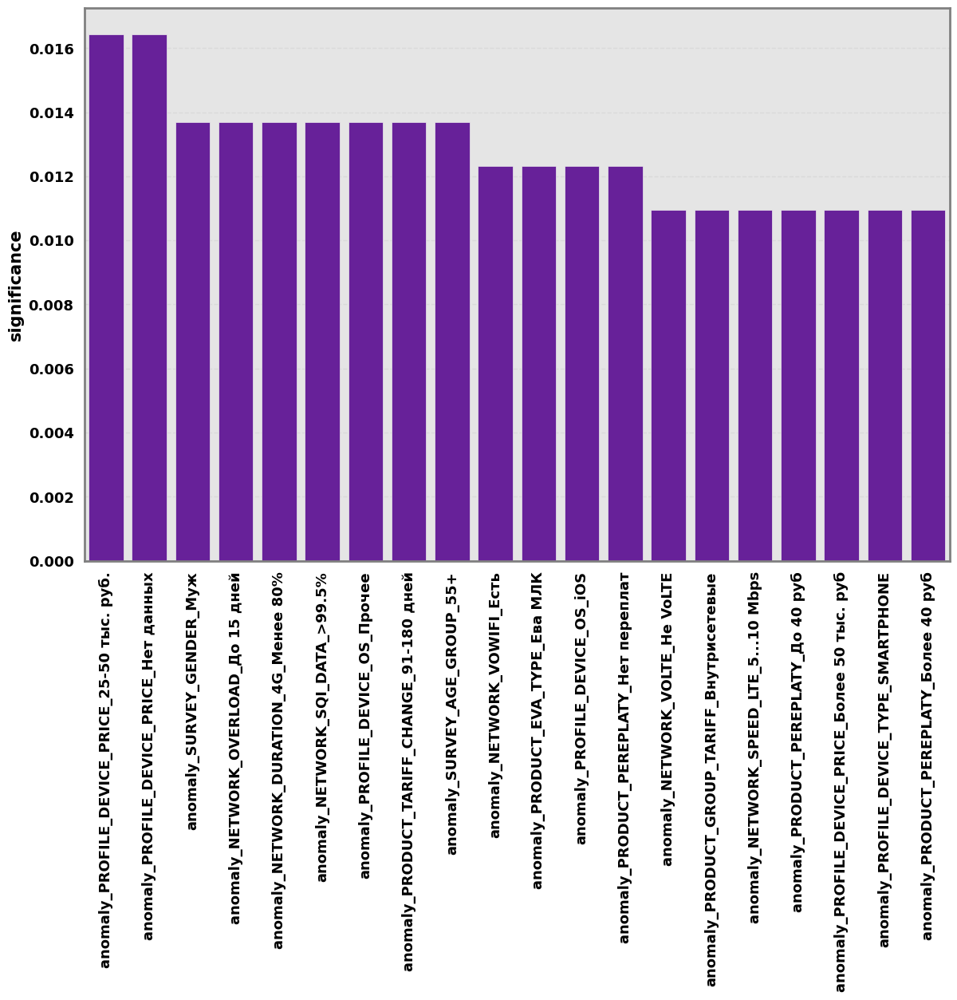

In [89]:
nps_result_significance_plot = nps_result_significance.sort_values('significance', ascending=False).head(20)
sns.barplot(x=nps_result_significance_plot.segment + '_' + nps_result_significance_plot.group,
            y=nps_result_significance_plot.significance)
plt.xlabel('')
plt.xticks(rotation=90);

### Inquiry

In [41]:
inquiry_result = pd.read_csv(inquiry_detector.output_dir / 'inquiry_significant_segments.csv')
inquiry_result.head()

,SNAP_DATE_DAY,FILIAL_ID,total_count,delta_FILIAL_ID_all,ml_anomaly_CAT_PYRAMID_NAME_significant,z_anomaly_CAT_PYRAMID_NAME_significant,anomaly_CAT_PYRAMID_NAME_significant,ml_anomaly_DESCRIPTION_significant,z_anomaly_DESCRIPTION_significant,anomaly_DESCRIPTION_significant,ml_anomaly_FLAG_LOCAL_GENERAL_significant,z_anomaly_FLAG_LOCAL_GENERAL_significant,anomaly_FLAG_LOCAL_GENERAL_significant,ml_anomaly_FULL_NAME_significant,z_anomaly_FULL_NAME_significant,anomaly_FULL_NAME_significant,ml_anomaly_SUBCAT_PYRAMID_NAME_significant,z_anomaly_SUBCAT_PYRAMID_NAME_significant,anomaly_SUBCAT_PYRAMID_NAME_significant
0,2023-01-01,11,11,8.0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
1,2023-01-02,19,19,8.0,False,VIP,False,False,Ошибка в счёте,False,False,False,False,False,False,False,False,Высокий ARPU,False
2,2023-01-03,8,8,-11.0,False,VIP,False,False,Проблема с сетью,False,False,0.0,False,False,Поломка оборудования,False,False,Низкий ARPU,False
3,2023-01-04,17,17,9.0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
4,2023-01-05,17,17,0.0,False,VIP,False,False,False,False,False,0.0,False,False,False,False,False,Высокий ARPU,False


In [42]:
inquiry_result_significance = calculate_all_segments_significance(inquiry_result)
inquiry_result_significance

,segment,group,significance
0,anomaly_CAT_PYRAMID_NAME,VIP,0.030137
1,anomaly_CAT_PYRAMID_NAME,Обычный,0.012329
0,anomaly_DESCRIPTION,Некачественный сервис,0.032877
1,anomaly_DESCRIPTION,Ошибка в счёте,0.013699
2,anomaly_DESCRIPTION,Проблема с сетью,0.005479
0,anomaly_FLAG_LOCAL_GENERAL,0.0,0.030137
1,anomaly_FLAG_LOCAL_GENERAL,1.0,0.015068
0,anomaly_FULL_NAME,Поломка оборудования,0.023288
1,anomaly_FULL_NAME,Технические работы,0.009589
0,anomaly_SUBCAT_PYRAMID_NAME,Низкий ARPU,0.036986


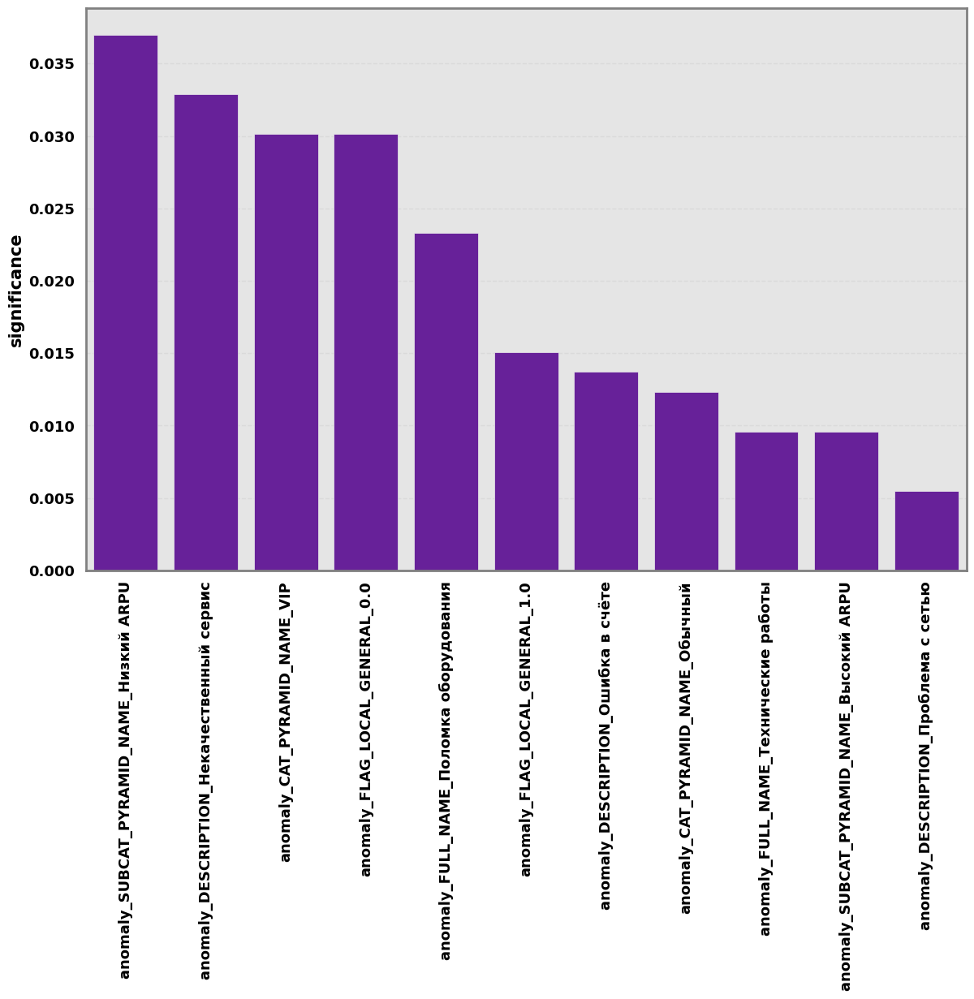

In [88]:
inquiry_result_significance_plot = inquiry_result_significance.sort_values('significance', ascending=False)
sns.barplot(x=inquiry_result_significance_plot.segment + '_' + inquiry_result_significance_plot.group,
            y=inquiry_result_significance_plot.significance)
plt.xlabel('')
plt.xticks(rotation=90);

---

# Significant segments in different `measure_id`
In this part, we will determine which segments are most significant for different surveys (`measure_id` column)

First, let's look at how our metrics change for different surveys in the time period under consideration.

[2025-03-27 11:40:23 INFO] src.pipeline.eda: Image saved in path: data/imgs/segments_nps_time/timeline_nps_KPI_NAME.png


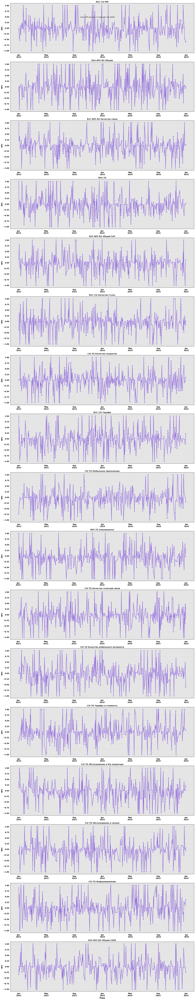

In [43]:
data_visualizer.plot_daily_dynamics_segment(
    **get_daily_nps_params('KPI_NAME')
)

[2025-03-27 11:40:43 INFO] src.pipeline.eda: Image saved in path: data/imgs/segments_inquiry_time/timeline_inquiry_KPI_NAME.png


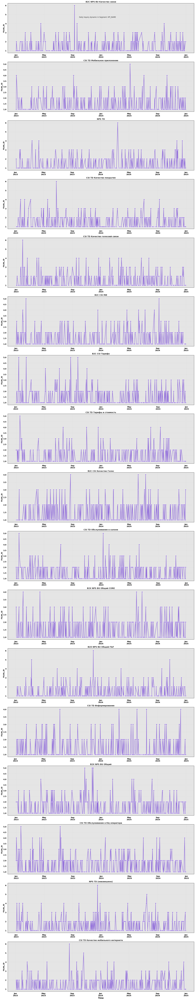

In [44]:
data_visualizer.plot_daily_dynamics_segment(
    **get_daily_inquiry_params('KPI_NAME')
)

Также посмотрим на корреляцию Total Inquiry и Mean NPS по разным measure_id

['B2C NPS BU Качество связи' 'CSI TD Мобильное приложение' 'NPS TD'
 'CSI TD Качество покрытия' 'CSI TD Качество голосовй связи' 'B2C CSI МИ'
 'B2C CSI Тарифа' 'CSI TD Тарифы и стоимость' 'B2C CSI Качество Голос'
 'CSI TD Обслуживание в салоне' 'B2X NPS BU Общий CORE'
 'B2X NPS BU Общий F&F' 'CSI TD Информирование' 'B2X NPS BU Общий'
 'CSI TD Обслуживание в КЦ оператора' 'NPS TD (невзвешено)'
 'CSI TD Качество мобильного интернета']


  0%|          | 0/17 [00:00<?, ?it/s]

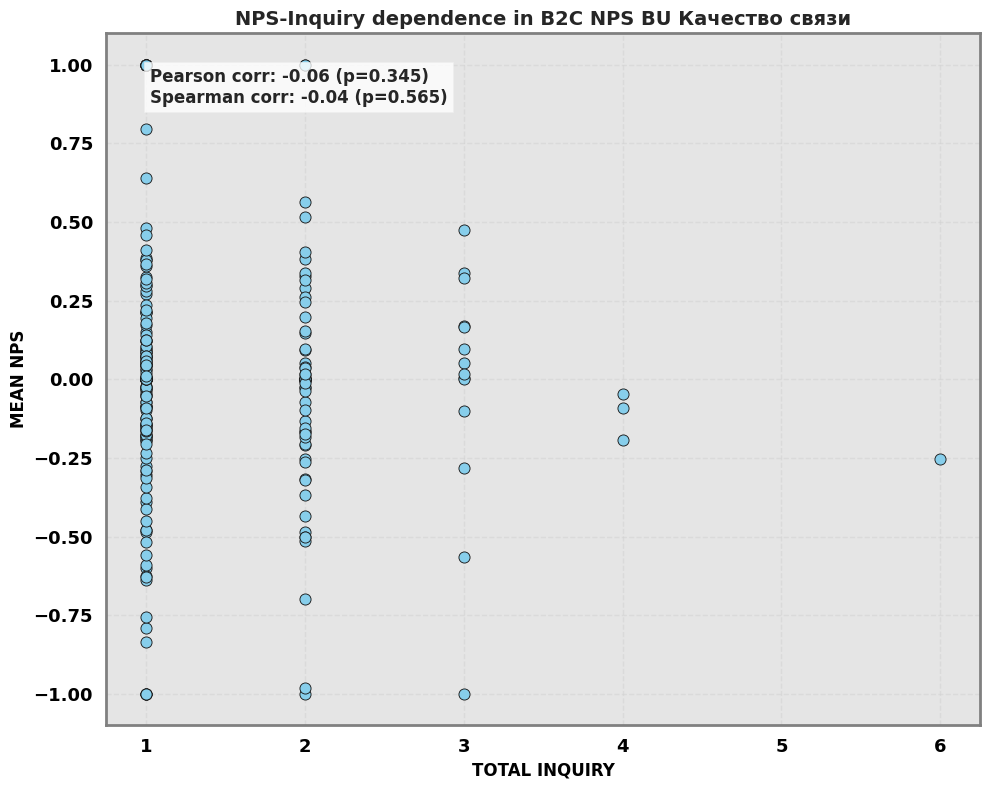

  6%|▌         | 1/17 [00:00<00:05,  3.18it/s]

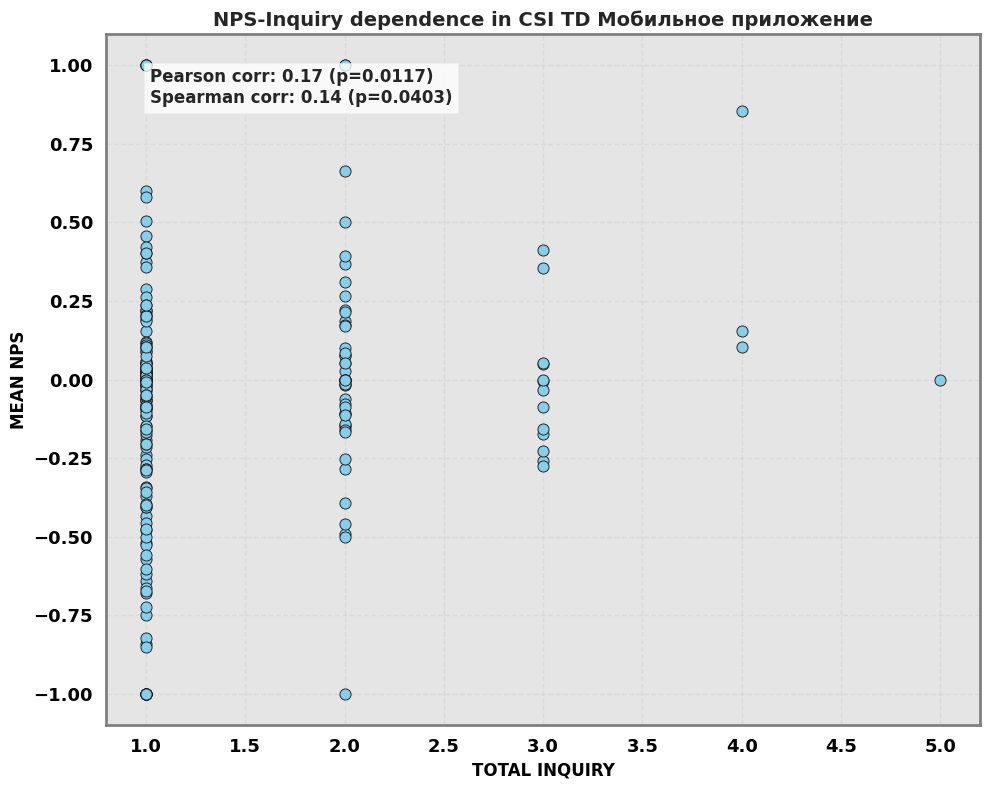

 12%|█▏        | 2/17 [00:00<00:04,  3.32it/s]

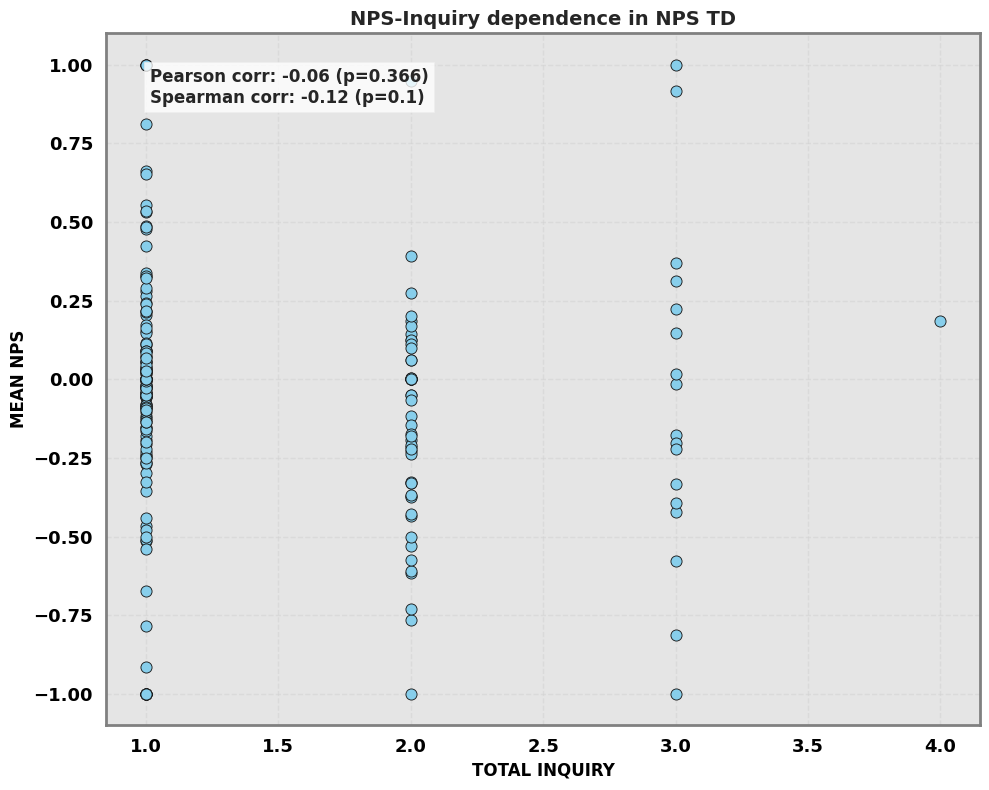

 18%|█▊        | 3/17 [00:00<00:03,  3.67it/s]

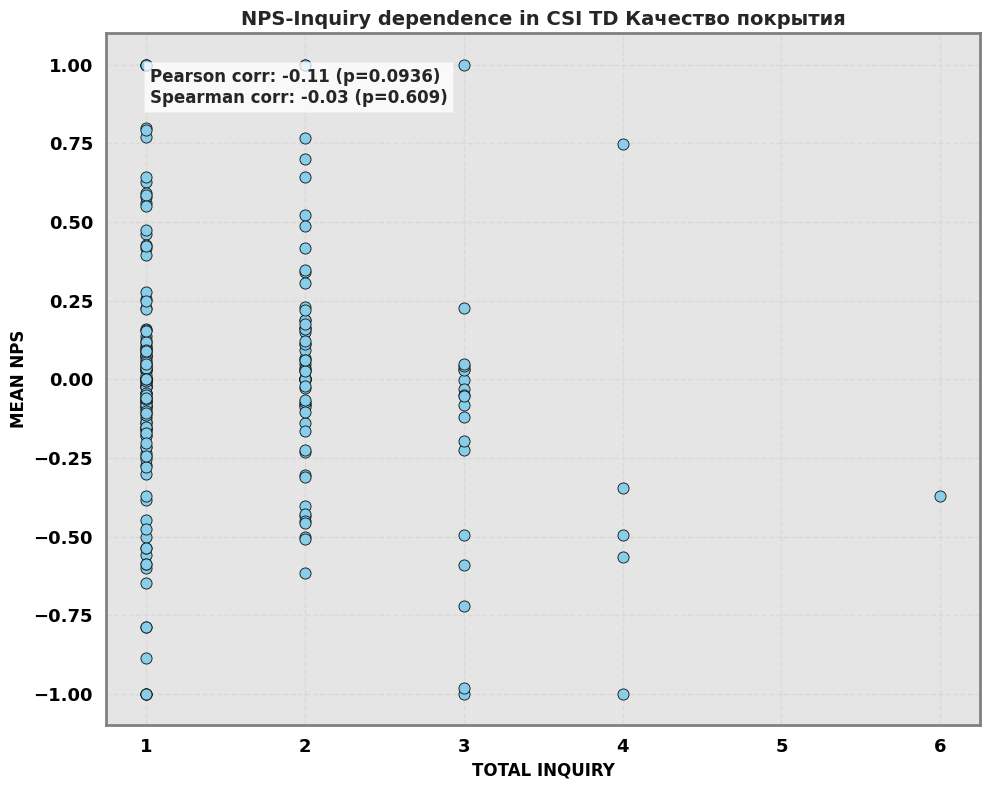

 24%|██▎       | 4/17 [00:01<00:04,  2.96it/s]

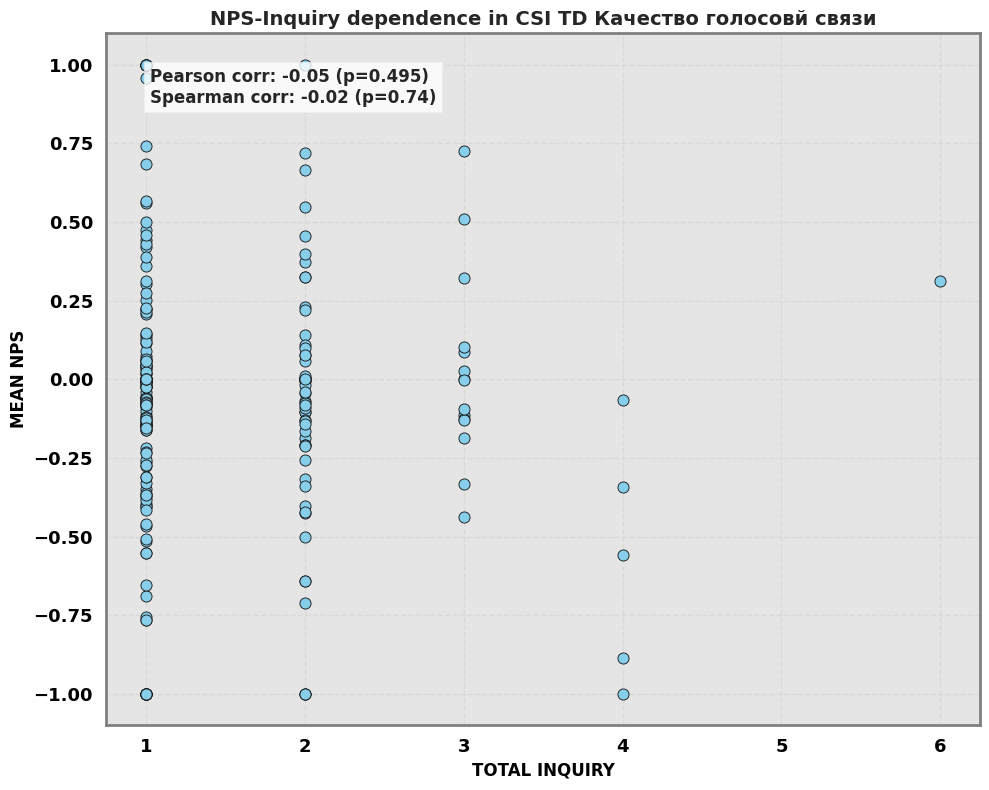

 29%|██▉       | 5/17 [00:01<00:03,  3.28it/s]

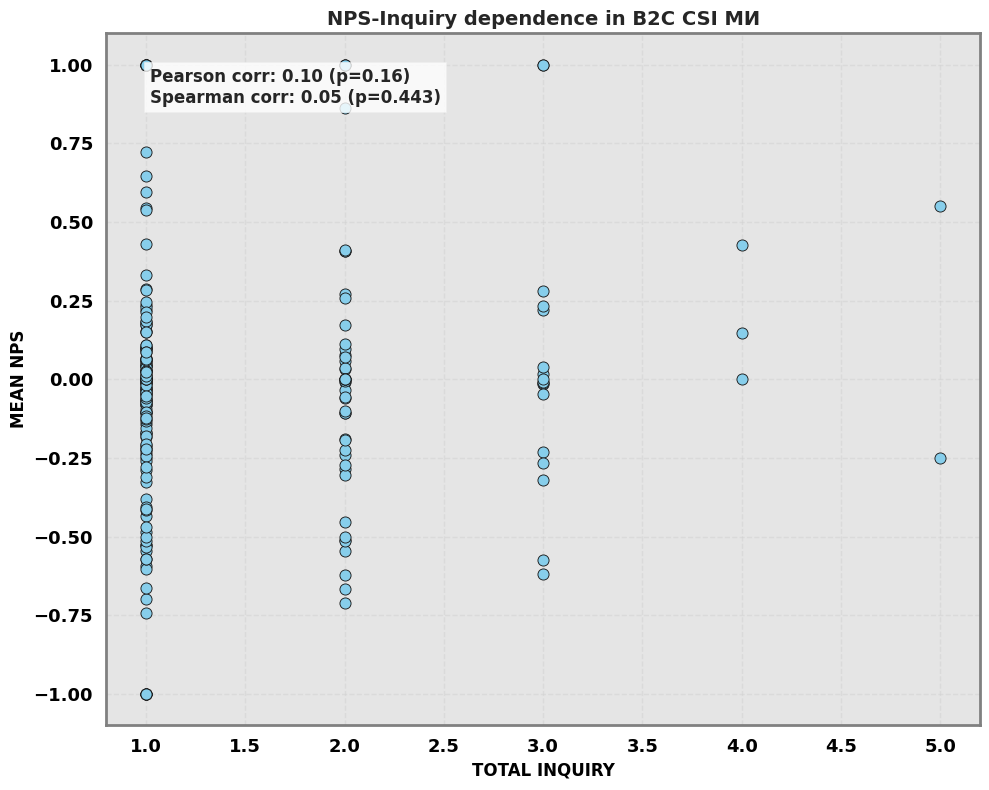

 35%|███▌      | 6/17 [00:01<00:03,  3.53it/s]

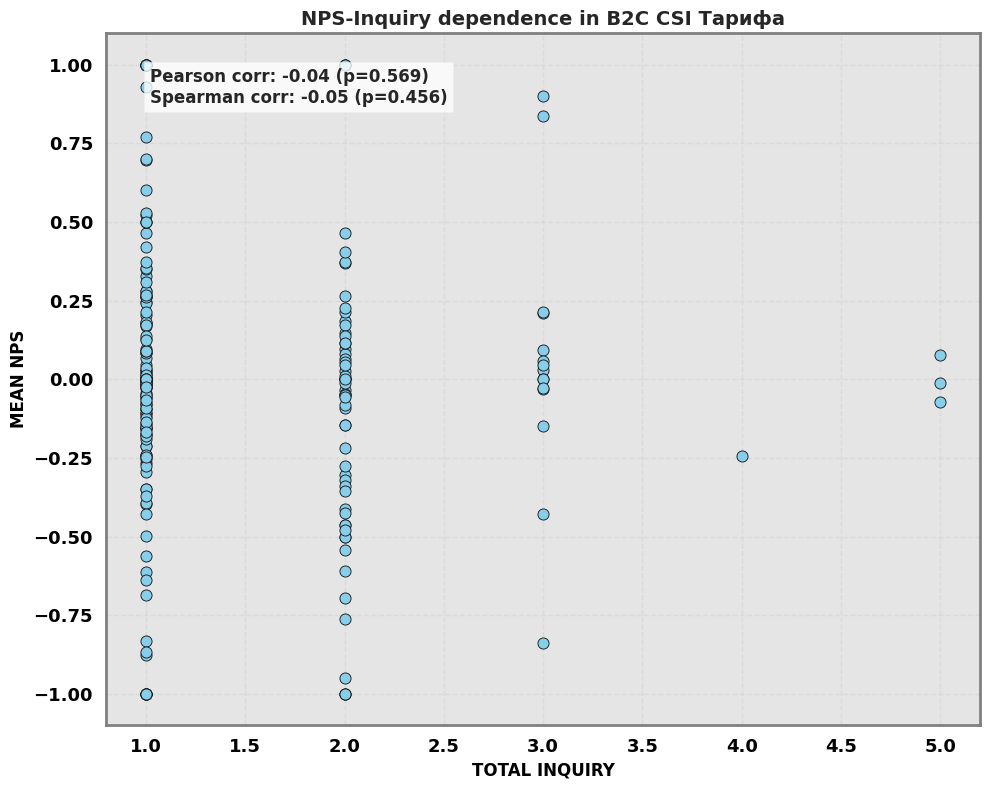

 41%|████      | 7/17 [00:02<00:02,  3.76it/s]

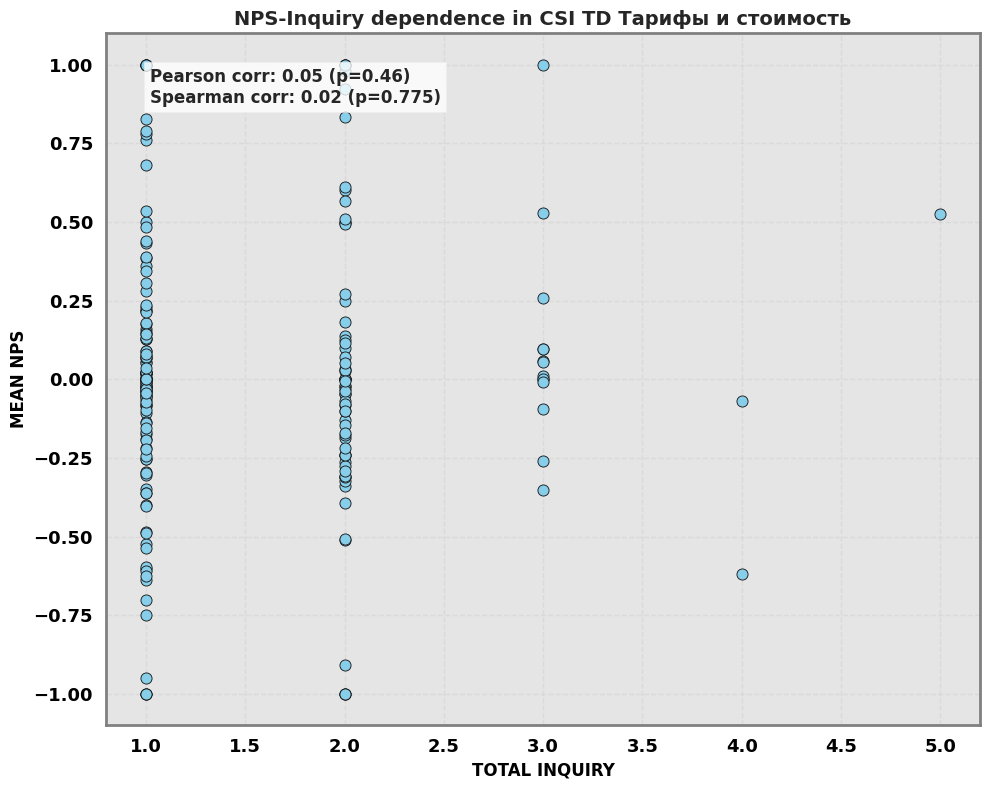

 47%|████▋     | 8/17 [00:02<00:02,  3.85it/s]

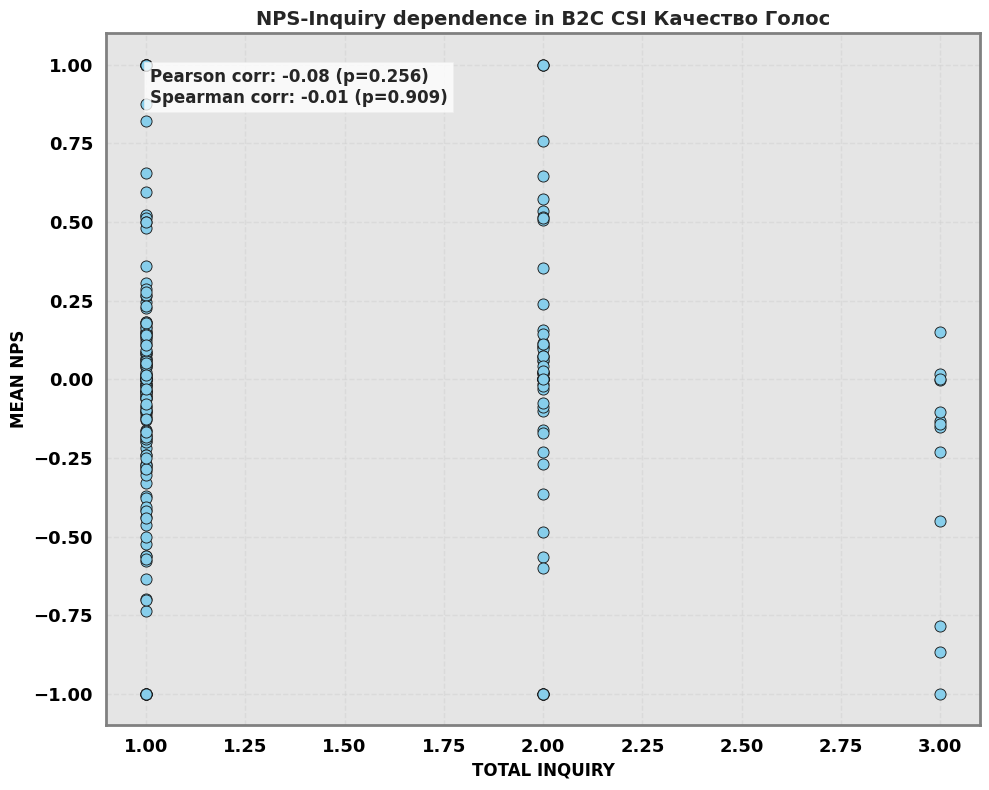

 53%|█████▎    | 9/17 [00:02<00:02,  3.92it/s]

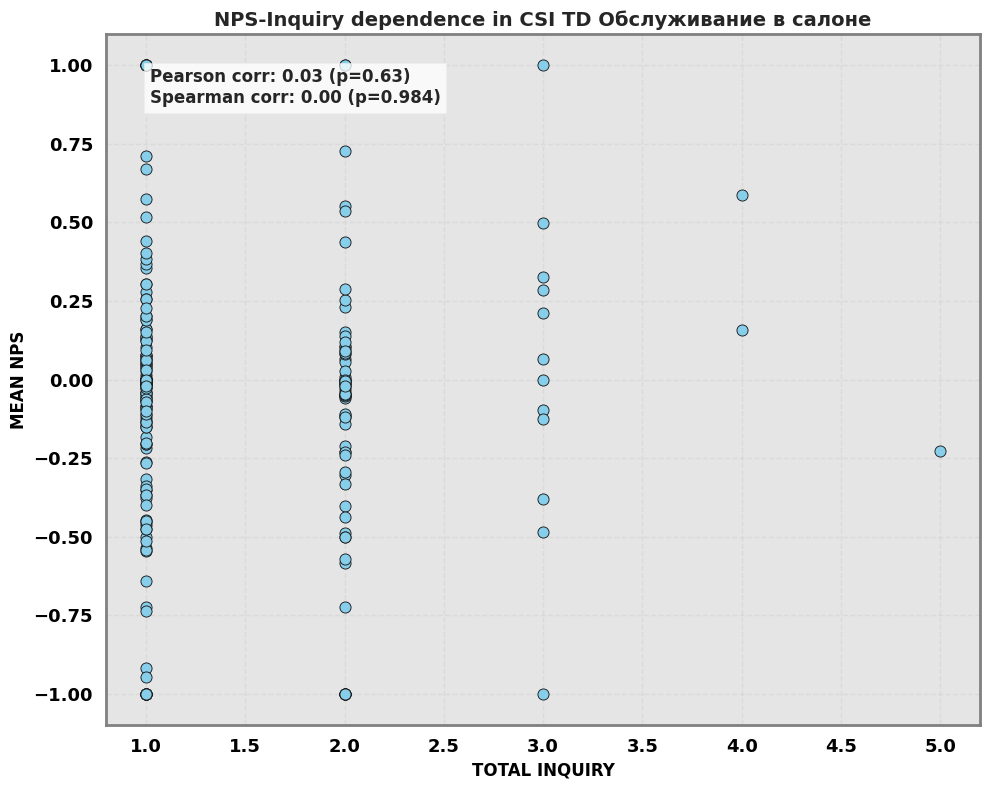

 59%|█████▉    | 10/17 [00:02<00:01,  3.83it/s]

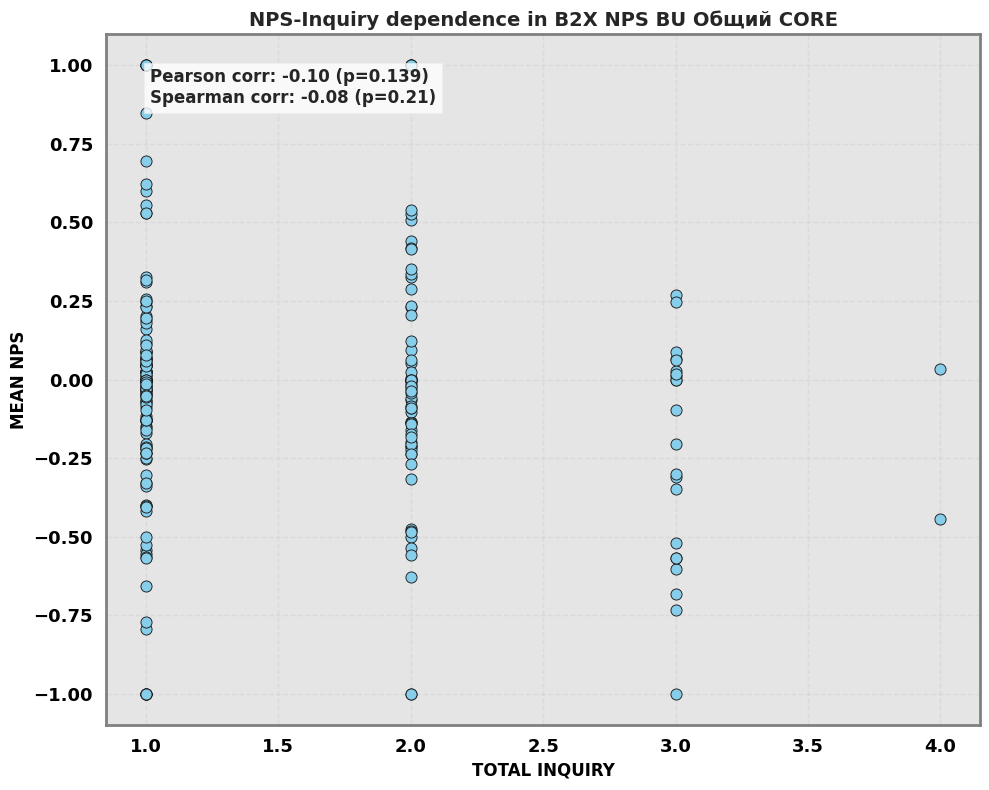

 65%|██████▍   | 11/17 [00:03<00:01,  3.91it/s]

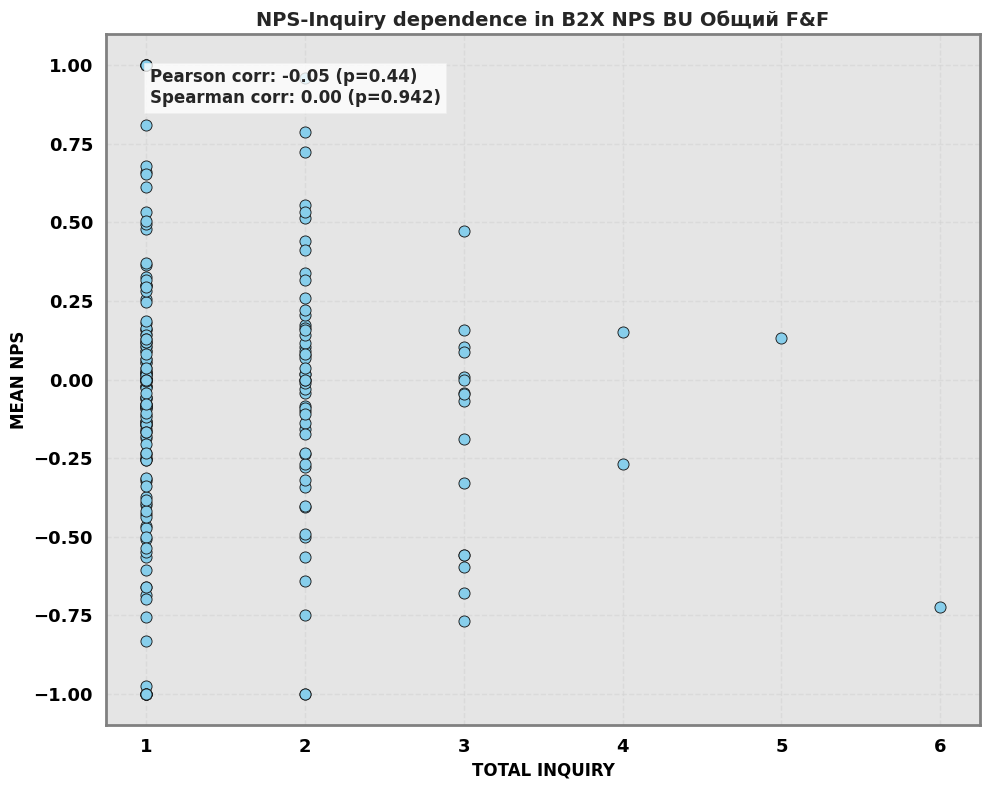

 71%|███████   | 12/17 [00:03<00:01,  3.88it/s]

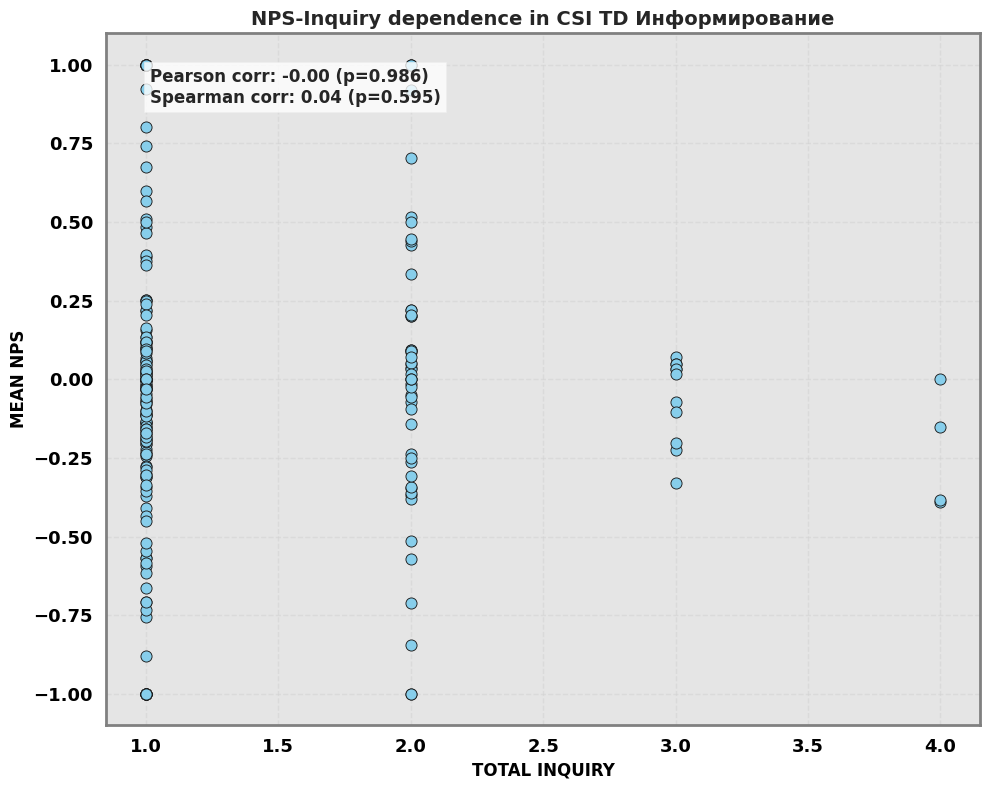

 76%|███████▋  | 13/17 [00:03<00:01,  3.92it/s]

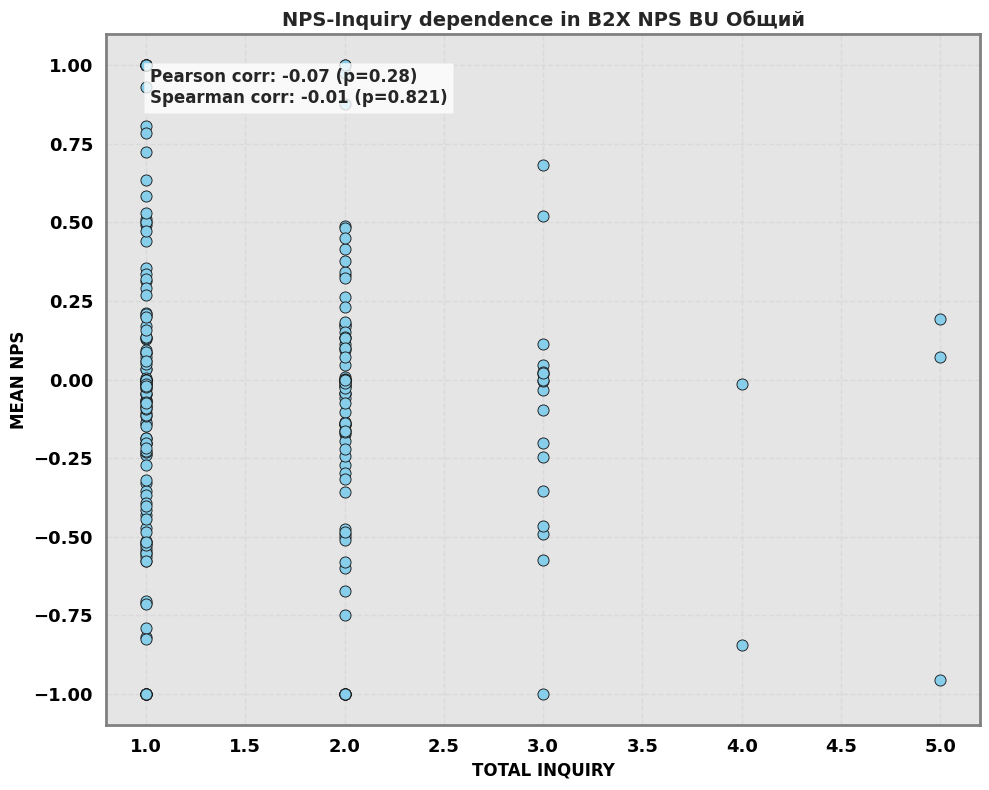

 82%|████████▏ | 14/17 [00:03<00:00,  3.92it/s]

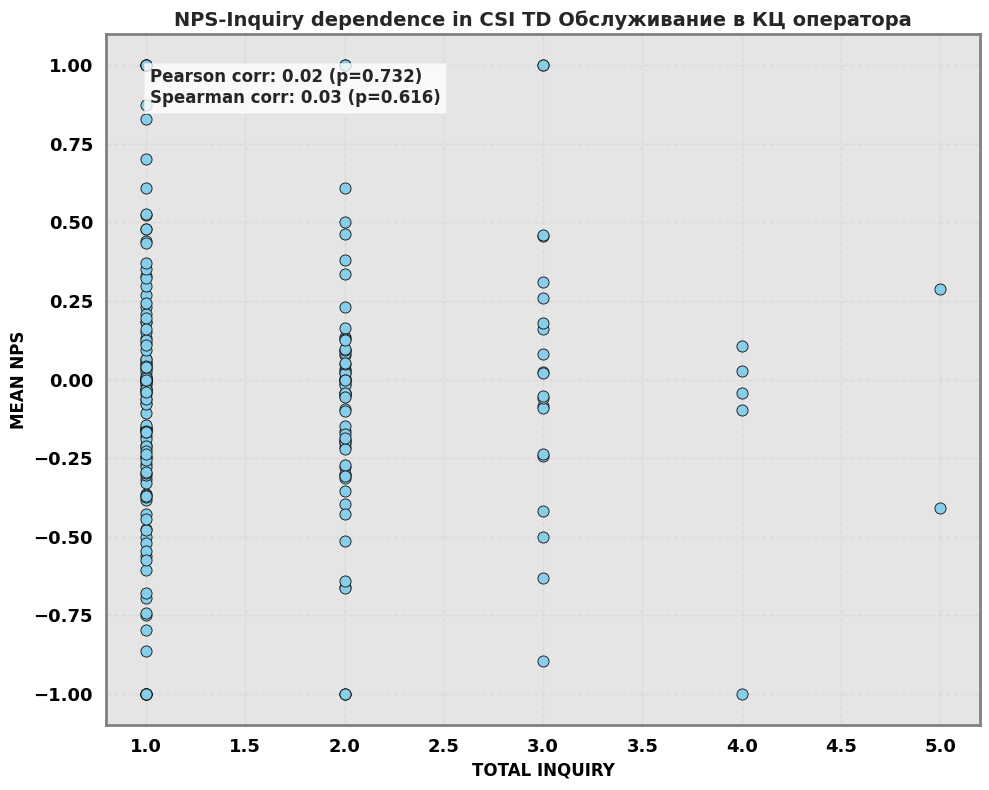

 88%|████████▊ | 15/17 [00:04<00:00,  4.01it/s]

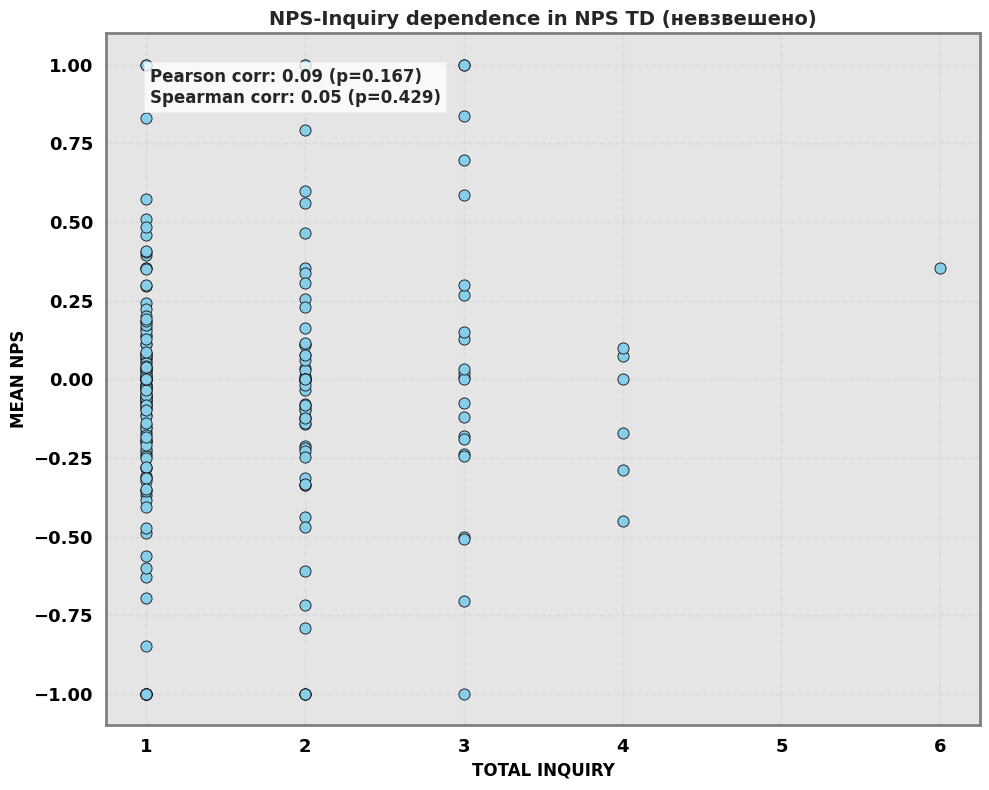

 94%|█████████▍| 16/17 [00:04<00:00,  4.09it/s]

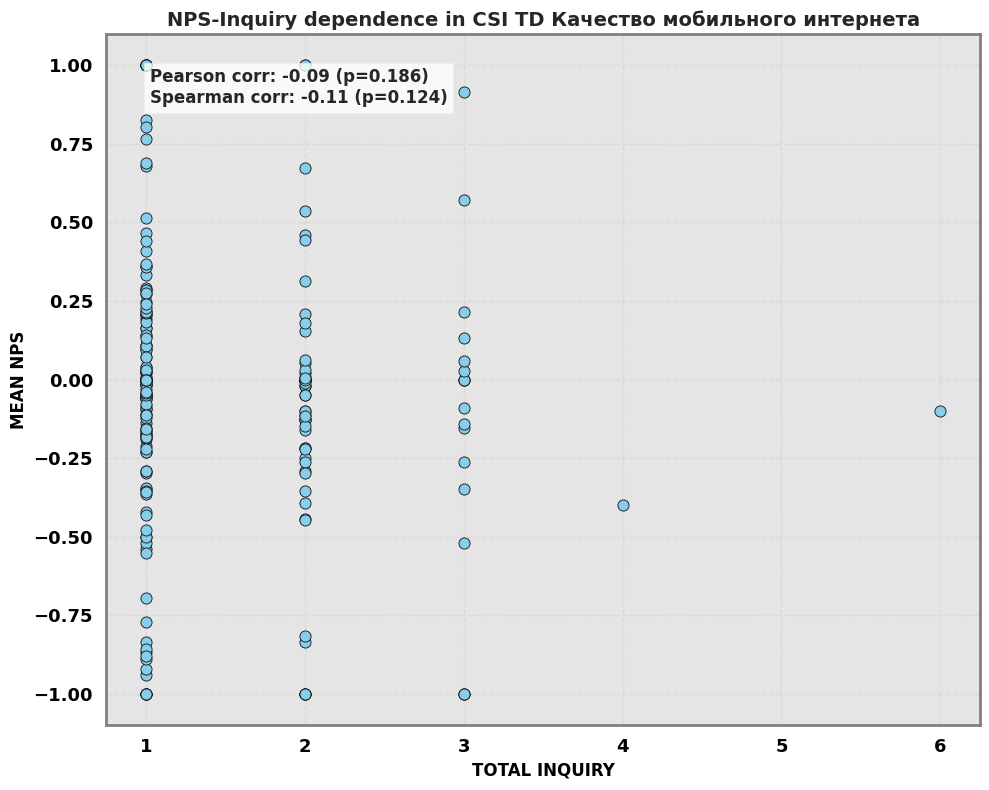

100%|██████████| 17/17 [00:04<00:00,  3.76it/s]


In [45]:
measure_ids = data_visualizer.df_inquiry.KPI_NAME.unique()
print(measure_ids)

for measure_id in tqdm(measure_ids, colour='CYAN'):
    inquiry_measure = data_visualizer.df_inquiry[data_visualizer.df_inquiry.KPI_NAME==measure_id]
    nps_measure = data_visualizer.df_nps[data_visualizer.df_nps.KPI_NAME==measure_id]

    data_visualizer.plot_correlation_daily_metrics(
        df1=inquiry_measure, df2=nps_measure,
        group_col1='FILIAL_ID', group_col2='NPS',
        func1='size', func2='mean',
        metric1_name='TOTAL INQUIRY', metric2_name='MEAN NPS',
        title=f'NPS-Inquiry dependence in {measure_id}',
        filename=f'nps_inquiry_{measure_id}'
    )

Теперь пройдемся по всем `measure_id` и для каждого определим свои важные сегменты.

In [50]:
measure2resdf_nps = {}
measure2resdf_inquiry = {}

for measure_id in tqdm(measure_ids, colour='CYAN'):
    nps_measure = data_visualizer.df_nps[data_visualizer.df_nps.KPI_NAME==measure_id]
    inquiry_measure = data_visualizer.df_inquiry[data_visualizer.df_inquiry.KPI_NAME==measure_id]

    nps_processor = NPSDataProcessor(data=nps_measure, output_name="nps_processed", **processor_params)
    inquiry_processor = InquiryDataProcessor(data=inquiry_measure, output_name="inquiry_processed", **processor_params)

    nps_processor.process()
    inquiry_processor.process()

    nps_detector = AnomalyDetector(metric_name="NPS", func='mean', **detector_params)
    inquiry_detector = AnomalyDetector(metric_name="FILIAL_ID", func='size', **detector_params)  # doesn't matter whih column to pass with size

    nps_measure_res = nps_detector.process_segments(df=nps_processor.data, output_name=None)
    inquiry_measure_res = inquiry_detector.process_segments(df=inquiry_processor.data, output_name=None)

    nps_measure_res_significance = calculate_all_segments_significance(nps_measure_res)
    inquiry_measure_res_significance = calculate_all_segments_significance(inquiry_measure_res)

    measure2resdf_nps[measure_id] = nps_measure_res_significance
    measure2resdf_inquiry[measure_id] = inquiry_measure_res_significance

    print('\n' + '-'*100 + '\n')  

  0%|          | 0/17 [00:00<?, ?it/s]

[2025-03-27 11:46:01 INFO] src.pipeline.preprocessing: NPSDataProcessor: Initial dataset shape: (602, 104)
[2025-03-27 11:46:01 INFO] src.pipeline.preprocessing: NPSDataProcessor: Initial dataset shape: (602, 106)
[2025-03-27 11:46:01 INFO] src.pipeline.preprocessing: NPSDataProcessor: Filling missing values using ML models...
[2025-03-27 11:46:01 INFO] src.pipeline.preprocessing: Initial missing values distribution: 
PROFILE_KINOPOISK               0
PRODUCT_EVA_TYPE                0
NETWORK_DURATION_2G             0
SURVEY_GENDER                  10
SURVEY_CITY_SIZE                9
NETWORK_VOWIFI                  0
REGION_FILIAL                   0
NETWORK_PROSTOI                 0
NETWORK_DURATION_4G             0
PROFILE_DEVICE_PRICE            0
SURVEY_OPERATOR_AGE_GROUP       0
PRODUCT_NAME_LINE_TP            0
SNAP_DATE_DAY                   0
PRODUCT_PEREPLATY               0
SURVEY_ARPU_GROUP               0
NETWORK_4G_SHARE                0
PROFILE_DEVICE_OS               0



----------------------------------------------------------------------------------------------------



[2025-03-27 11:46:26 INFO] src.pipeline.anomalies_detector: Processing segment: FILIAL_ID
[2025-03-27 11:46:26 INFO] src.pipeline.anomalies_detector: Total groups in segment: 19
[2025-03-27 11:46:28 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_4G_SHARE
[2025-03-27 11:46:28 INFO] src.pipeline.anomalies_detector: Total groups in segment: 4
[2025-03-27 11:46:28 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_DURATION_2G
[2025-03-27 11:46:28 INFO] src.pipeline.anomalies_detector: Total groups in segment: 4
[2025-03-27 11:46:29 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_DURATION_4G
[2025-03-27 11:46:29 INFO] src.pipeline.anomalies_detector: Total groups in segment: 3
[2025-03-27 11:46:29 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_OVERLOAD
[2025-03-27 11:46:29 INFO] src.pipeline.anomalies_detector: Total groups in segment: 3
[2025-03-27 11:46:28 INFO] src.pipeline.anomalies_detector: Processing segment: 


----------------------------------------------------------------------------------------------------



[2025-03-27 11:46:49 INFO] src.pipeline.anomalies_detector: Processing segment: FILIAL_ID
[2025-03-27 11:46:49 INFO] src.pipeline.anomalies_detector: Total groups in segment: 19
[2025-03-27 11:46:51 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_4G_SHARE
[2025-03-27 11:46:51 INFO] src.pipeline.anomalies_detector: Total groups in segment: 4
[2025-03-27 11:46:52 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_DURATION_2G
[2025-03-27 11:46:52 INFO] src.pipeline.anomalies_detector: Total groups in segment: 4
[2025-03-27 11:46:52 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_DURATION_4G
[2025-03-27 11:46:52 INFO] src.pipeline.anomalies_detector: Total groups in segment: 3
[2025-03-27 11:46:52 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_OVERLOAD
[2025-03-27 11:46:52 INFO] src.pipeline.anomalies_detector: Total groups in segment: 3
[2025-03-27 11:46:53 INFO] src.pipeline.anomalies_detector: Processing segment: 


----------------------------------------------------------------------------------------------------



[2025-03-27 11:47:13 INFO] src.pipeline.anomalies_detector: Processing segment: FILIAL_ID
[2025-03-27 11:47:13 INFO] src.pipeline.anomalies_detector: Total groups in segment: 19
[2025-03-27 11:47:15 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_4G_SHARE
[2025-03-27 11:47:15 INFO] src.pipeline.anomalies_detector: Total groups in segment: 4
[2025-03-27 11:47:15 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_DURATION_2G
[2025-03-27 11:47:15 INFO] src.pipeline.anomalies_detector: Total groups in segment: 4
[2025-03-27 11:47:16 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_DURATION_4G
[2025-03-27 11:47:16 INFO] src.pipeline.anomalies_detector: Total groups in segment: 3
[2025-03-27 11:47:16 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_OVERLOAD
[2025-03-27 11:47:16 INFO] src.pipeline.anomalies_detector: Total groups in segment: 3
[2025-03-27 11:47:17 INFO] src.pipeline.anomalies_detector: Processing segment: 


----------------------------------------------------------------------------------------------------



[2025-03-27 11:47:36 INFO] src.pipeline.anomalies_detector: Processing segment: FILIAL_ID
[2025-03-27 11:47:36 INFO] src.pipeline.anomalies_detector: Total groups in segment: 19
[2025-03-27 11:47:38 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_4G_SHARE
[2025-03-27 11:47:38 INFO] src.pipeline.anomalies_detector: Total groups in segment: 4
[2025-03-27 11:47:39 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_DURATION_2G
[2025-03-27 11:47:39 INFO] src.pipeline.anomalies_detector: Total groups in segment: 4
[2025-03-27 11:47:39 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_DURATION_4G
[2025-03-27 11:47:39 INFO] src.pipeline.anomalies_detector: Total groups in segment: 3
[2025-03-27 11:47:39 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_OVERLOAD
[2025-03-27 11:47:39 INFO] src.pipeline.anomalies_detector: Total groups in segment: 3
[2025-03-27 11:47:40 INFO] src.pipeline.anomalies_detector: Processing segment: 


----------------------------------------------------------------------------------------------------



[2025-03-27 11:48:01 INFO] src.pipeline.anomalies_detector: Processing segment: FILIAL_ID
[2025-03-27 11:48:01 INFO] src.pipeline.anomalies_detector: Total groups in segment: 19
[2025-03-27 11:48:03 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_4G_SHARE
[2025-03-27 11:48:02 INFO] src.pipeline.anomalies_detector: Total groups in segment: 4
[2025-03-27 11:48:02 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_DURATION_2G
[2025-03-27 11:48:02 INFO] src.pipeline.anomalies_detector: Total groups in segment: 4
[2025-03-27 11:48:03 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_DURATION_4G
[2025-03-27 11:48:03 INFO] src.pipeline.anomalies_detector: Total groups in segment: 3
[2025-03-27 11:48:03 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_OVERLOAD
[2025-03-27 11:48:03 INFO] src.pipeline.anomalies_detector: Total groups in segment: 3
[2025-03-27 11:48:03 INFO] src.pipeline.anomalies_detector: Processing segment: 


----------------------------------------------------------------------------------------------------



[2025-03-27 11:48:24 INFO] src.pipeline.anomalies_detector: Processing segment: FILIAL_ID
[2025-03-27 11:48:24 INFO] src.pipeline.anomalies_detector: Total groups in segment: 19
[2025-03-27 11:48:25 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_4G_SHARE
[2025-03-27 11:48:25 INFO] src.pipeline.anomalies_detector: Total groups in segment: 4
[2025-03-27 11:48:26 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_DURATION_2G
[2025-03-27 11:48:26 INFO] src.pipeline.anomalies_detector: Total groups in segment: 4
[2025-03-27 11:48:26 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_DURATION_4G
[2025-03-27 11:48:26 INFO] src.pipeline.anomalies_detector: Total groups in segment: 3
[2025-03-27 11:48:27 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_OVERLOAD
[2025-03-27 11:48:27 INFO] src.pipeline.anomalies_detector: Total groups in segment: 3
[2025-03-27 11:48:27 INFO] src.pipeline.anomalies_detector: Processing segment: 


----------------------------------------------------------------------------------------------------



[2025-03-27 11:48:46 INFO] src.pipeline.anomalies_detector: Processing segment: FILIAL_ID
[2025-03-27 11:48:46 INFO] src.pipeline.anomalies_detector: Total groups in segment: 19
[2025-03-27 11:48:48 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_4G_SHARE
[2025-03-27 11:48:48 INFO] src.pipeline.anomalies_detector: Total groups in segment: 4
[2025-03-27 11:48:49 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_DURATION_2G
[2025-03-27 11:48:49 INFO] src.pipeline.anomalies_detector: Total groups in segment: 4
[2025-03-27 11:48:49 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_DURATION_4G
[2025-03-27 11:48:49 INFO] src.pipeline.anomalies_detector: Total groups in segment: 3
[2025-03-27 11:48:49 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_OVERLOAD
[2025-03-27 11:48:49 INFO] src.pipeline.anomalies_detector: Total groups in segment: 3
[2025-03-27 11:48:50 INFO] src.pipeline.anomalies_detector: Processing segment: 


----------------------------------------------------------------------------------------------------



[2025-03-27 11:49:10 INFO] src.pipeline.anomalies_detector: Processing segment: FILIAL_ID
[2025-03-27 11:49:10 INFO] src.pipeline.anomalies_detector: Total groups in segment: 19
[2025-03-27 11:49:12 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_4G_SHARE
[2025-03-27 11:49:12 INFO] src.pipeline.anomalies_detector: Total groups in segment: 4
[2025-03-27 11:49:12 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_DURATION_2G
[2025-03-27 11:49:12 INFO] src.pipeline.anomalies_detector: Total groups in segment: 4
[2025-03-27 11:49:12 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_DURATION_4G
[2025-03-27 11:49:12 INFO] src.pipeline.anomalies_detector: Total groups in segment: 3
[2025-03-27 11:49:13 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_OVERLOAD
[2025-03-27 11:49:13 INFO] src.pipeline.anomalies_detector: Total groups in segment: 3
[2025-03-27 11:49:13 INFO] src.pipeline.anomalies_detector: Processing segment: 


----------------------------------------------------------------------------------------------------



[2025-03-27 11:49:34 INFO] src.pipeline.anomalies_detector: Processing segment: FILIAL_ID
[2025-03-27 11:49:34 INFO] src.pipeline.anomalies_detector: Total groups in segment: 19
[2025-03-27 11:49:35 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_4G_SHARE
[2025-03-27 11:49:35 INFO] src.pipeline.anomalies_detector: Total groups in segment: 4
[2025-03-27 11:49:36 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_DURATION_2G
[2025-03-27 11:49:36 INFO] src.pipeline.anomalies_detector: Total groups in segment: 4
[2025-03-27 11:49:36 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_DURATION_4G
[2025-03-27 11:49:36 INFO] src.pipeline.anomalies_detector: Total groups in segment: 3
[2025-03-27 11:49:35 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_OVERLOAD
[2025-03-27 11:49:35 INFO] src.pipeline.anomalies_detector: Total groups in segment: 3
[2025-03-27 11:49:36 INFO] src.pipeline.anomalies_detector: Processing segment: 


----------------------------------------------------------------------------------------------------



[2025-03-27 11:49:56 INFO] src.pipeline.anomalies_detector: Processing segment: FILIAL_ID
[2025-03-27 11:49:56 INFO] src.pipeline.anomalies_detector: Total groups in segment: 19
[2025-03-27 11:49:58 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_4G_SHARE
[2025-03-27 11:49:58 INFO] src.pipeline.anomalies_detector: Total groups in segment: 4
[2025-03-27 11:49:58 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_DURATION_2G
[2025-03-27 11:49:58 INFO] src.pipeline.anomalies_detector: Total groups in segment: 4
[2025-03-27 11:49:59 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_DURATION_4G
[2025-03-27 11:49:59 INFO] src.pipeline.anomalies_detector: Total groups in segment: 3
[2025-03-27 11:49:59 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_OVERLOAD
[2025-03-27 11:49:59 INFO] src.pipeline.anomalies_detector: Total groups in segment: 3
[2025-03-27 11:49:59 INFO] src.pipeline.anomalies_detector: Processing segment: 


----------------------------------------------------------------------------------------------------



[2025-03-27 11:50:19 INFO] src.pipeline.anomalies_detector: Processing segment: FILIAL_ID
[2025-03-27 11:50:19 INFO] src.pipeline.anomalies_detector: Total groups in segment: 19
[2025-03-27 11:50:20 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_4G_SHARE
[2025-03-27 11:50:20 INFO] src.pipeline.anomalies_detector: Total groups in segment: 4
[2025-03-27 11:50:21 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_DURATION_2G
[2025-03-27 11:50:21 INFO] src.pipeline.anomalies_detector: Total groups in segment: 4
[2025-03-27 11:50:21 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_DURATION_4G
[2025-03-27 11:50:21 INFO] src.pipeline.anomalies_detector: Total groups in segment: 3
[2025-03-27 11:50:22 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_OVERLOAD
[2025-03-27 11:50:22 INFO] src.pipeline.anomalies_detector: Total groups in segment: 3
[2025-03-27 11:50:22 INFO] src.pipeline.anomalies_detector: Processing segment: 


----------------------------------------------------------------------------------------------------



[2025-03-27 11:50:41 INFO] src.pipeline.anomalies_detector: Processing segment: FILIAL_ID
[2025-03-27 11:50:41 INFO] src.pipeline.anomalies_detector: Total groups in segment: 19
[2025-03-27 11:50:43 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_4G_SHARE
[2025-03-27 11:50:43 INFO] src.pipeline.anomalies_detector: Total groups in segment: 4
[2025-03-27 11:50:44 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_DURATION_2G
[2025-03-27 11:50:44 INFO] src.pipeline.anomalies_detector: Total groups in segment: 4
[2025-03-27 11:50:44 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_DURATION_4G
[2025-03-27 11:50:44 INFO] src.pipeline.anomalies_detector: Total groups in segment: 3
[2025-03-27 11:50:44 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_OVERLOAD
[2025-03-27 11:50:44 INFO] src.pipeline.anomalies_detector: Total groups in segment: 3
[2025-03-27 11:50:45 INFO] src.pipeline.anomalies_detector: Processing segment: 


----------------------------------------------------------------------------------------------------



[2025-03-27 11:51:05 INFO] src.pipeline.anomalies_detector: Processing segment: FILIAL_ID
[2025-03-27 11:51:05 INFO] src.pipeline.anomalies_detector: Total groups in segment: 19
[2025-03-27 11:51:07 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_4G_SHARE
[2025-03-27 11:51:07 INFO] src.pipeline.anomalies_detector: Total groups in segment: 4
[2025-03-27 11:51:08 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_DURATION_2G
[2025-03-27 11:51:08 INFO] src.pipeline.anomalies_detector: Total groups in segment: 4
[2025-03-27 11:51:08 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_DURATION_4G
[2025-03-27 11:51:08 INFO] src.pipeline.anomalies_detector: Total groups in segment: 3
[2025-03-27 11:51:08 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_OVERLOAD
[2025-03-27 11:51:08 INFO] src.pipeline.anomalies_detector: Total groups in segment: 3
[2025-03-27 11:51:09 INFO] src.pipeline.anomalies_detector: Processing segment: 


----------------------------------------------------------------------------------------------------



[2025-03-27 11:51:29 INFO] src.pipeline.anomalies_detector: Processing segment: FILIAL_ID
[2025-03-27 11:51:29 INFO] src.pipeline.anomalies_detector: Total groups in segment: 19
[2025-03-27 11:51:31 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_4G_SHARE
[2025-03-27 11:51:31 INFO] src.pipeline.anomalies_detector: Total groups in segment: 4
[2025-03-27 11:51:31 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_DURATION_2G
[2025-03-27 11:51:31 INFO] src.pipeline.anomalies_detector: Total groups in segment: 4
[2025-03-27 11:51:32 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_DURATION_4G
[2025-03-27 11:51:32 INFO] src.pipeline.anomalies_detector: Total groups in segment: 3
[2025-03-27 11:51:32 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_OVERLOAD
[2025-03-27 11:51:32 INFO] src.pipeline.anomalies_detector: Total groups in segment: 3
[2025-03-27 11:51:32 INFO] src.pipeline.anomalies_detector: Processing segment: 


----------------------------------------------------------------------------------------------------



[2025-03-27 11:51:52 INFO] src.pipeline.anomalies_detector: Processing segment: FILIAL_ID
[2025-03-27 11:51:52 INFO] src.pipeline.anomalies_detector: Total groups in segment: 19
[2025-03-27 11:51:53 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_4G_SHARE
[2025-03-27 11:51:53 INFO] src.pipeline.anomalies_detector: Total groups in segment: 4
[2025-03-27 11:51:54 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_DURATION_2G
[2025-03-27 11:51:54 INFO] src.pipeline.anomalies_detector: Total groups in segment: 4
[2025-03-27 11:51:54 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_DURATION_4G
[2025-03-27 11:51:54 INFO] src.pipeline.anomalies_detector: Total groups in segment: 3
[2025-03-27 11:51:54 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_OVERLOAD
[2025-03-27 11:51:54 INFO] src.pipeline.anomalies_detector: Total groups in segment: 3
[2025-03-27 11:51:55 INFO] src.pipeline.anomalies_detector: Processing segment: 


----------------------------------------------------------------------------------------------------



[2025-03-27 11:52:14 INFO] src.pipeline.anomalies_detector: Processing segment: FILIAL_ID
[2025-03-27 11:52:14 INFO] src.pipeline.anomalies_detector: Total groups in segment: 19
[2025-03-27 11:52:16 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_4G_SHARE
[2025-03-27 11:52:16 INFO] src.pipeline.anomalies_detector: Total groups in segment: 4
[2025-03-27 11:52:16 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_DURATION_2G
[2025-03-27 11:52:16 INFO] src.pipeline.anomalies_detector: Total groups in segment: 4
[2025-03-27 11:52:16 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_DURATION_4G
[2025-03-27 11:52:16 INFO] src.pipeline.anomalies_detector: Total groups in segment: 3
[2025-03-27 11:52:17 INFO] src.pipeline.anomalies_detector: Processing segment: NETWORK_OVERLOAD
[2025-03-27 11:52:17 INFO] src.pipeline.anomalies_detector: Total groups in segment: 3
[2025-03-27 11:52:17 INFO] src.pipeline.anomalies_detector: Processing segment: 


----------------------------------------------------------------------------------------------------



In [51]:
measure2resdf_nps.keys()

dict_keys(['B2C NPS BU Качество связи', 'CSI TD Мобильное приложение', 'NPS TD', 'CSI TD Качество покрытия', 'CSI TD Качество голосовй связи', 'B2C CSI МИ', 'B2C CSI Тарифа', 'CSI TD Тарифы и стоимость', 'B2C CSI Качество Голос', 'CSI TD Обслуживание в салоне', 'B2X NPS BU Общий CORE', 'B2X NPS BU Общий F&F', 'CSI TD Информирование', 'B2X NPS BU Общий', 'CSI TD Обслуживание в КЦ оператора', 'NPS TD (невзвешено)', 'CSI TD Качество мобильного интернета'])

In [77]:
def plot_significance(result_df: pd.DataFrame, k: int=10, title: str=''):
    plt.close()
    result_df = result_df[result_df.group != False]
    result_df = result_df.sort_values('significance', ascending=False).head(k)

    sns.barplot(x=result_df.segment + result_df.group, y=result_df.significance)
    plt.xticks(rotation=90)
    plt.xlabel('segment-group')
    plt.title(title)

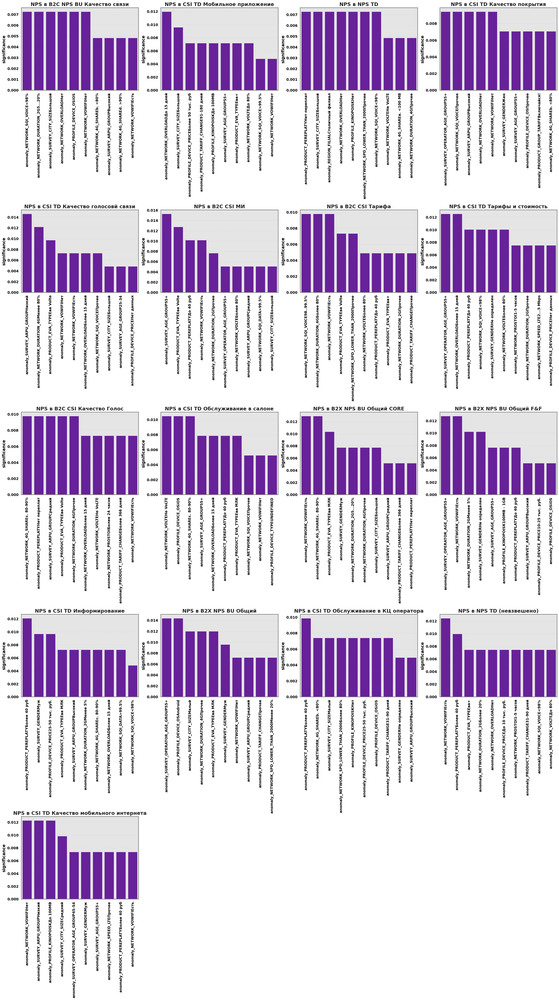

In [103]:
import math
import numpy as np

k = 10
num_measures = len(measure2resdf_nps)
num_cols = 4
num_rows = math.ceil(num_measures / num_cols)

fig, axes = plt.subplots(num_rows, num_cols, figsize=(num_cols * 7, num_rows * 10))

axes = np.array(axes).reshape(num_rows, num_cols)

for ax, (measure_id, result_df) in zip(axes.flatten(), measure2resdf_nps.items()):
    result_df = result_df[result_df.group != False]
    result_df = result_df.sort_values('significance', ascending=False).head(k)
    
    sns.barplot(x=result_df.segment + result_df.group, y=result_df.significance, ax=ax)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
    ax.set_xlabel('')
    ax.set_title(f'NPS в {measure_id}')

for ax in axes.flatten()[num_measures:]:
    ax.axis("off")

plt.tight_layout()
plt.show()

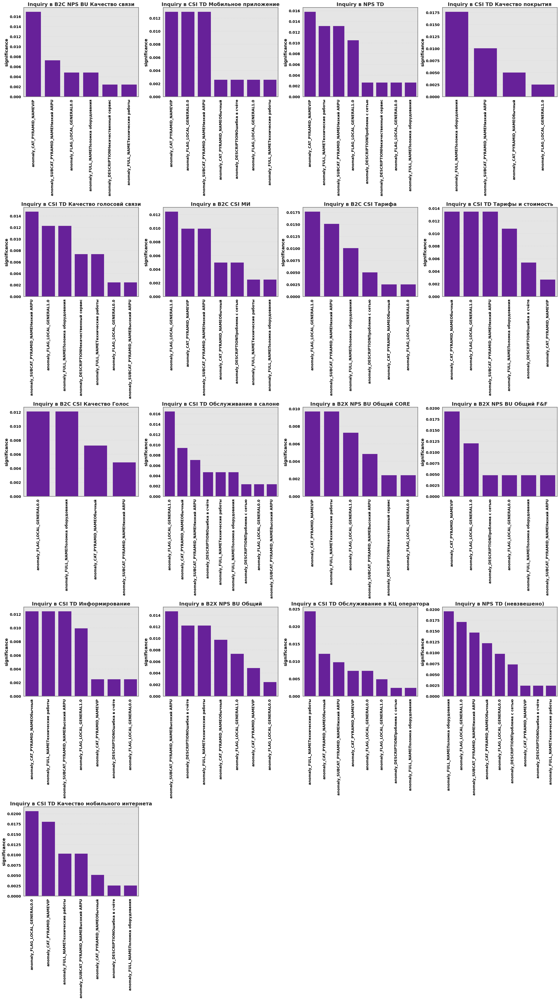

In [104]:
k = 10
num_measures = len(measure2resdf_inquiry)
num_cols = 4
num_rows = math.ceil(num_measures / num_cols)

fig, axes = plt.subplots(num_rows, num_cols, figsize=(num_cols * 7, num_rows * 10))

axes = np.array(axes).reshape(num_rows, num_cols)

for ax, (measure_id, result_df) in zip(axes.flatten(), measure2resdf_inquiry.items()):
    result_df = result_df[result_df.group != False]
    result_df = result_df.sort_values('significance', ascending=False).head(k)
    
    sns.barplot(x=result_df.segment + result_df.group, y=result_df.significance, ax=ax)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
    ax.set_xlabel('')
    ax.set_title(f'Inquiry в {measure_id}')

for ax in axes.flatten()[num_measures:]:
    ax.axis("off")

plt.tight_layout()
plt.show()

# Plans
- Отрисовка аномалий на графиках
- Сегменты 2-го и 3-го уровней